# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
# data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

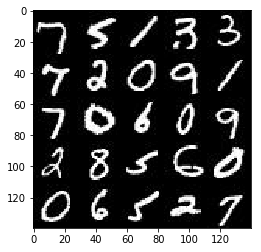

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

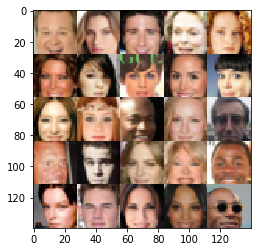

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.3.1
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function

    real_dim = (image_width, image_height, image_channels)
    
    # Real images placeholder
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim))
    
    # Generator input placeholder
    z = tf.placeholder(tf.float32, (None, z_dim))
    
    # Learning rate
    learning_rate = tf.placeholder(tf.float32, shape=())
    
    return inputs_real, z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False, alpha=0.1):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function

    with tf.variable_scope('discriminator', reuse=reuse):
     
        # First convolutional layer - 14 x 14 x 64
        conv1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        conv1r = tf.maximum(alpha * conv1, conv1)
        conv1r = tf.nn.dropout(conv1r, keep_prob=0.8)
        
        # Second convolutional layer - 7 x 7 x 128
        conv2 = tf.layers.conv2d(conv1r, 128, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        conv2n = tf.layers.batch_normalization(conv2, training=True)
        conv2r = tf.maximum(alpha * conv2n, conv2n)
        conv2r = tf.nn.dropout(conv2r, keep_prob=0.8)
        
        # Third convolutional layer - 4 x 4 x 256
        conv3 = tf.layers.conv2d(conv2r, 256, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        conv3n = tf.layers.batch_normalization(conv3, training=True)
        conv3r = tf.maximum(alpha * conv3n, conv3n)
        conv3r = tf.nn.dropout(conv3r, keep_prob=0.8)
        
        # Fourth convolutional layer - 2 x 2 x 512
        conv4 = tf.layers.conv2d(conv3r, 512, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        conv4n = tf.layers.batch_normalization(conv4, training=True)
        conv4r = tf.maximum(alpha * conv4n, conv4n)
        conv4r = tf.nn.dropout(conv4r, keep_prob=0.8)
                
        # Reshape output for the final layer
        reshape = tf.reshape(conv4r,(-1, 8 * 64 * 2 * 2))
        
        # Logits
        logits = tf.layers.dense(reshape, 1)
        
        # Output
        out = tf.sigmoid(logits)
     

    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True, alpha=0.1):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    
    with tf.variable_scope('generator', reuse= not is_train):
        
        # Dense layer
        d = tf.layers.dense(z, 16 * 32 * 3 * 3)
        dr = tf.reshape(d, (-1, 3, 3, 16 * 32))
        drn = tf.layers.batch_normalization(dr, training=is_train)
        drnr = tf.maximum(alpha * drn, drn)
        
        # First transpose convolution - 7 x 7 x 128
        c1 = tf.layers.conv2d_transpose(drnr, 128, 3, strides=2, padding='valid', kernel_initializer=tf.contrib.layers.xavier_initializer())
        c1n = tf.layers.batch_normalization(c1, training=is_train)
        c1nr = tf.maximum(alpha * c1n, c1n)
        
        # Second transpose convolution - 14 x 14 x 64 
        c2 = tf.layers.conv2d_transpose(c1nr, 64, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        c2n = tf.layers.batch_normalization(c2, training=is_train)
        c2nr = tf.maximum(alpha * c2n, c2n)
        
        # Third transpose convolution - 28 x 28 x 32
        c3 = tf.layers.conv2d_transpose(c2nr, 32, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        c3n = tf.layers.batch_normalization(c3, training=is_train)
        c3nr = tf.maximum(alpha * c3n, c3n)
        
        # Fourth transpose convolution - 28 x 28 x out_channel_dim
        c4 = tf.layers.conv2d_transpose(c3nr, out_channel_dim, 5, strides=1, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        
        # Output
        out = tf.tanh(c4)        
    
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    
    g_model = generator(input_z, out_channel_dim, is_train=True)
    
    # Real images from discriminator
    d_model_real, d_logits_real = discriminator(input_real, reuse=False)
    
    # Fake images from discriminator
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    # Discriminator real images loss
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real) * 0.9))
    
    # Discriminator fake images loss
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    
    # Generator loss
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))
    
    # Discriminator loss
    d_loss = d_loss_real + d_loss_fake
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    
    # Trainable variables
    t_vars = tf.trainable_variables()
    
    # Trainable discriminator variables
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    
    # Trainable generator variables
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    
    # Generator update
    gen_updates = [op for op in update_ops if op.name.startswith('generator')]
    
    # Optimizers
    with tf.control_dependencies(gen_updates):
        
        # Train optimizer for Discriminator
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        
        # Train optimizer for Generator
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)
    
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    
    
   # Number of color channels
    _, image_w, image_h, n_channels = data_shape
    
    # Model input
    img, z, lr = model_inputs(image_w, image_h, n_channels, z_dim)
    
    # Losses
    d_loss, g_loss = model_loss(img, z, n_channels)
    
    # Optimizers
    d_opt, g_opt = model_opt(d_loss, g_loss, lr, beta1)
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            
            # Set initial steps and sums
            steps = 0
            d_loss_sum = 0
            g_loss_sum = 0
            batch_count = 0
            
            for batch_images in get_batches(batch_size):
                
                steps += 1
                batch_count += 1
                batch_images = batch_images * 2
                
                # Sample random noise for generator
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                # Run optimizers
                _ = sess.run(d_opt, feed_dict={img: batch_images, z: batch_z, lr: learning_rate})
                _ = sess.run(g_opt, feed_dict={z: batch_z, lr: learning_rate})

                # Update loss sums
                d_loss_sum += d_loss.eval({z: batch_z, img: batch_images})
                g_loss_sum += g_loss.eval({z: batch_z})

                # Print the losses
                if steps%20 == 0:
                    
                    # Generator output
                    show_generator_output(sess, 16, z, n_channels, data_image_mode)
                    
                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Avg. Discriminator Loss: {:.4f}...".format(d_loss_sum / batch_count),
                          "Avg. Generator Loss: {:.4f}".format(g_loss_sum / batch_count))   
                    
                    # Set loss sums back to zero
                    d_loss_sum = 0
                    g_loss_sum = 0
                    
                    # Set batch count back to zero
                    batch_count = 0
                
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

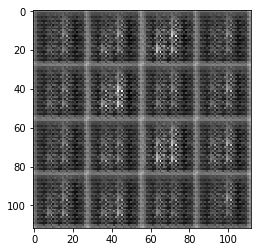

Epoch 1/2... Avg. Discriminator Loss: 2.8858... Avg. Generator Loss: 1.8170


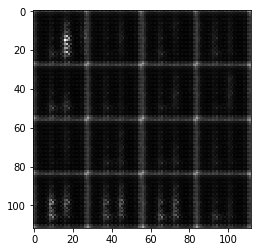

Epoch 1/2... Avg. Discriminator Loss: 1.3854... Avg. Generator Loss: 1.7870


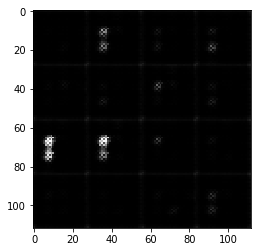

Epoch 1/2... Avg. Discriminator Loss: 1.1946... Avg. Generator Loss: 1.6179


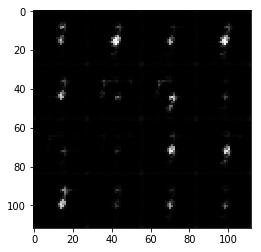

Epoch 1/2... Avg. Discriminator Loss: 1.3567... Avg. Generator Loss: 1.4536


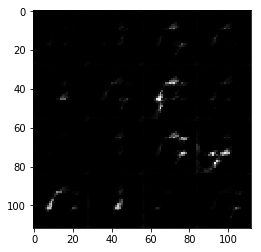

Epoch 1/2... Avg. Discriminator Loss: 1.2434... Avg. Generator Loss: 1.6437


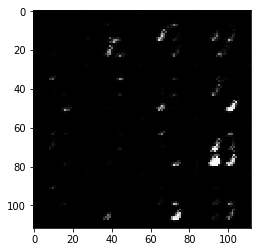

Epoch 1/2... Avg. Discriminator Loss: 1.3486... Avg. Generator Loss: 1.2923


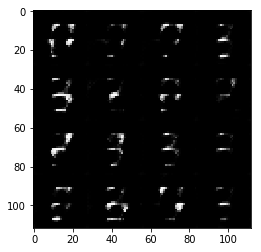

Epoch 1/2... Avg. Discriminator Loss: 1.3151... Avg. Generator Loss: 1.0927


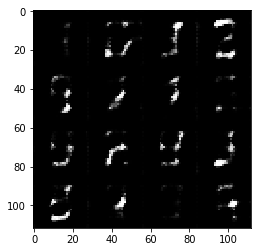

Epoch 1/2... Avg. Discriminator Loss: 1.2868... Avg. Generator Loss: 1.3015


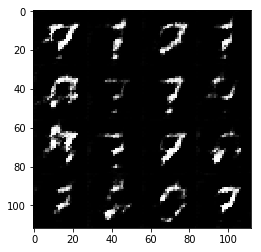

Epoch 1/2... Avg. Discriminator Loss: 1.3815... Avg. Generator Loss: 1.3507


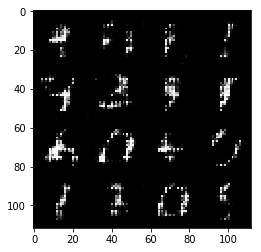

Epoch 1/2... Avg. Discriminator Loss: 1.1334... Avg. Generator Loss: 1.1936


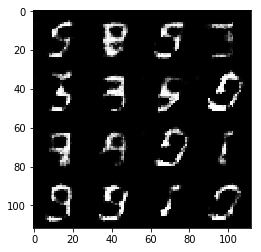

Epoch 1/2... Avg. Discriminator Loss: 1.2630... Avg. Generator Loss: 1.1750


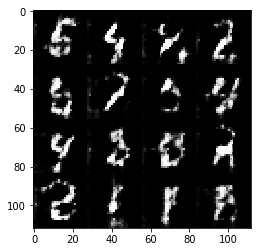

Epoch 1/2... Avg. Discriminator Loss: 1.2772... Avg. Generator Loss: 1.0924


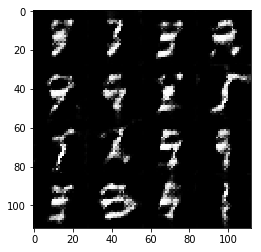

Epoch 1/2... Avg. Discriminator Loss: 1.3499... Avg. Generator Loss: 1.0228


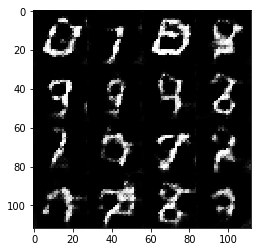

Epoch 1/2... Avg. Discriminator Loss: 1.2509... Avg. Generator Loss: 1.1467


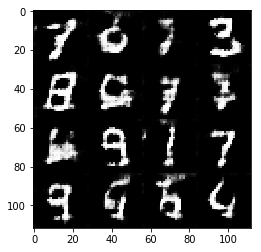

Epoch 1/2... Avg. Discriminator Loss: 1.2452... Avg. Generator Loss: 1.1059


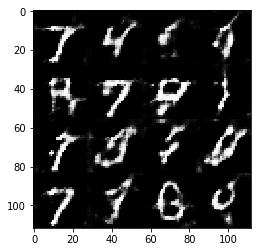

Epoch 1/2... Avg. Discriminator Loss: 1.1611... Avg. Generator Loss: 1.0592


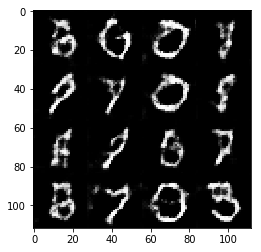

Epoch 1/2... Avg. Discriminator Loss: 1.2245... Avg. Generator Loss: 1.1244


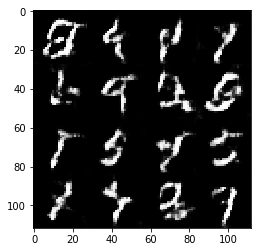

Epoch 1/2... Avg. Discriminator Loss: 1.2253... Avg. Generator Loss: 1.1062


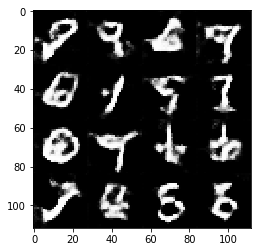

Epoch 1/2... Avg. Discriminator Loss: 1.2815... Avg. Generator Loss: 1.1092


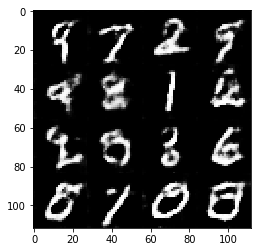

Epoch 1/2... Avg. Discriminator Loss: 1.1971... Avg. Generator Loss: 1.0583


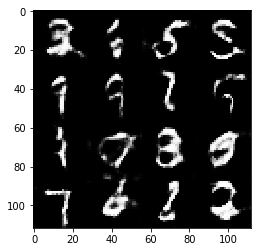

Epoch 1/2... Avg. Discriminator Loss: 1.1873... Avg. Generator Loss: 1.1378


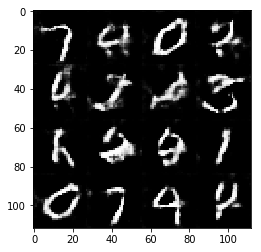

Epoch 1/2... Avg. Discriminator Loss: 1.1629... Avg. Generator Loss: 1.0314


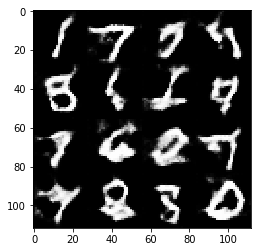

Epoch 1/2... Avg. Discriminator Loss: 1.2323... Avg. Generator Loss: 1.0758


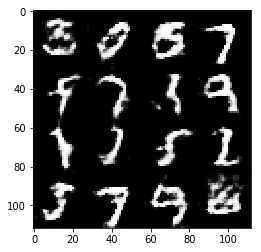

Epoch 1/2... Avg. Discriminator Loss: 1.2255... Avg. Generator Loss: 1.0896


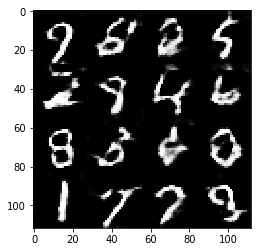

Epoch 1/2... Avg. Discriminator Loss: 1.3099... Avg. Generator Loss: 1.1322


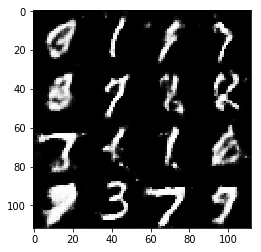

Epoch 1/2... Avg. Discriminator Loss: 1.1859... Avg. Generator Loss: 1.0587


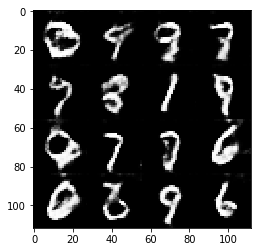

Epoch 1/2... Avg. Discriminator Loss: 1.1743... Avg. Generator Loss: 1.0431


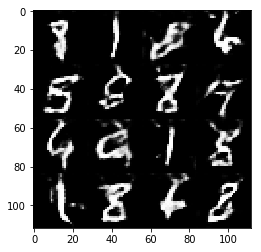

Epoch 1/2... Avg. Discriminator Loss: 1.1802... Avg. Generator Loss: 1.1182


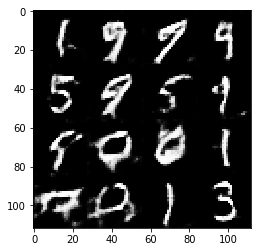

Epoch 1/2... Avg. Discriminator Loss: 1.2311... Avg. Generator Loss: 1.0782


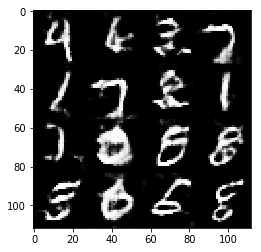

Epoch 1/2... Avg. Discriminator Loss: 1.2309... Avg. Generator Loss: 1.0704


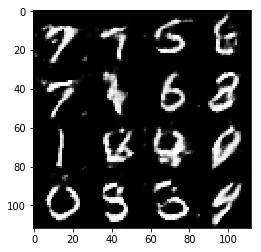

Epoch 1/2... Avg. Discriminator Loss: 1.2390... Avg. Generator Loss: 1.0280


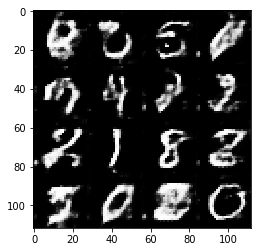

Epoch 1/2... Avg. Discriminator Loss: 1.2804... Avg. Generator Loss: 0.9875


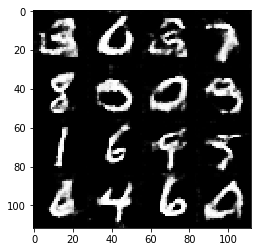

Epoch 1/2... Avg. Discriminator Loss: 1.2126... Avg. Generator Loss: 0.9703


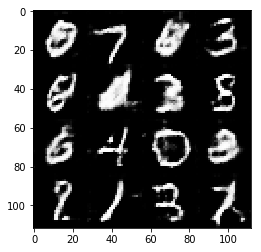

Epoch 1/2... Avg. Discriminator Loss: 1.2577... Avg. Generator Loss: 1.1304


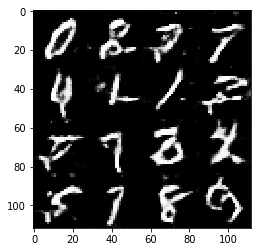

Epoch 1/2... Avg. Discriminator Loss: 1.2251... Avg. Generator Loss: 0.9839


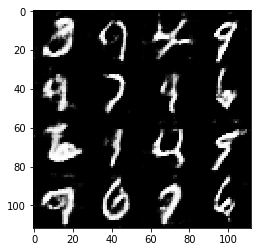

Epoch 1/2... Avg. Discriminator Loss: 1.2319... Avg. Generator Loss: 0.9915


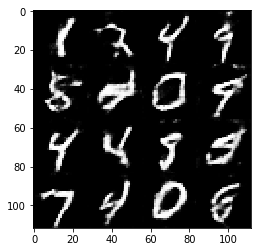

Epoch 1/2... Avg. Discriminator Loss: 1.2454... Avg. Generator Loss: 1.0419


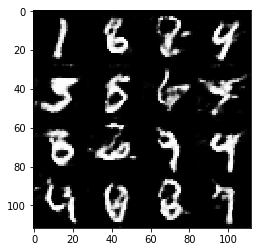

Epoch 1/2... Avg. Discriminator Loss: 1.2771... Avg. Generator Loss: 0.9890


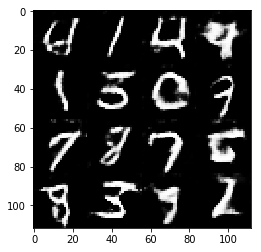

Epoch 1/2... Avg. Discriminator Loss: 1.2578... Avg. Generator Loss: 0.9796


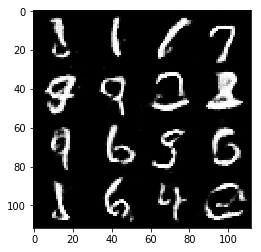

Epoch 1/2... Avg. Discriminator Loss: 1.2152... Avg. Generator Loss: 1.0143


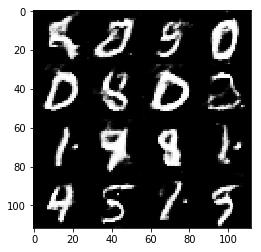

Epoch 1/2... Avg. Discriminator Loss: 1.3043... Avg. Generator Loss: 1.0757


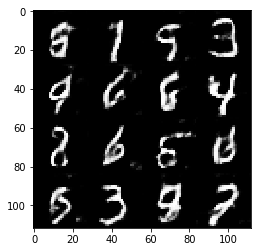

Epoch 1/2... Avg. Discriminator Loss: 1.2496... Avg. Generator Loss: 0.9387


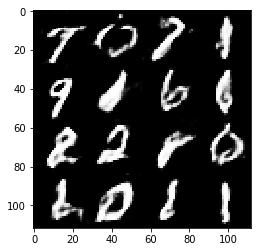

Epoch 1/2... Avg. Discriminator Loss: 1.2953... Avg. Generator Loss: 1.0712


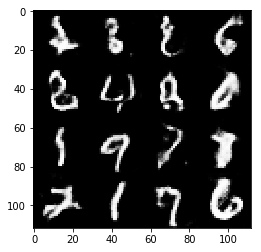

Epoch 1/2... Avg. Discriminator Loss: 1.2698... Avg. Generator Loss: 0.8804


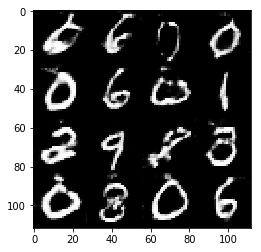

Epoch 1/2... Avg. Discriminator Loss: 1.1599... Avg. Generator Loss: 1.0253


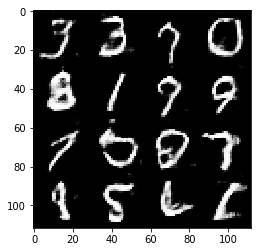

Epoch 1/2... Avg. Discriminator Loss: 1.2497... Avg. Generator Loss: 0.9320


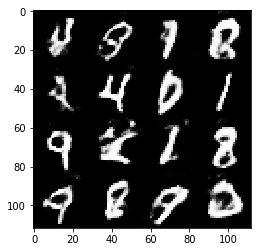

Epoch 2/2... Avg. Discriminator Loss: 1.2310... Avg. Generator Loss: 0.9370


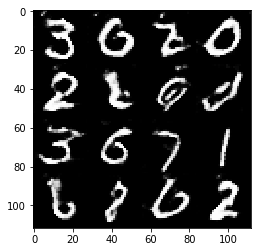

Epoch 2/2... Avg. Discriminator Loss: 1.2628... Avg. Generator Loss: 0.9329


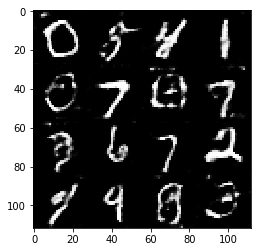

Epoch 2/2... Avg. Discriminator Loss: 1.3508... Avg. Generator Loss: 0.9533


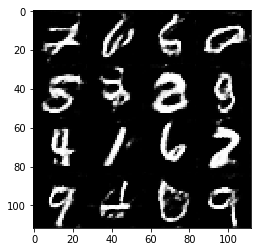

Epoch 2/2... Avg. Discriminator Loss: 1.2930... Avg. Generator Loss: 0.8574


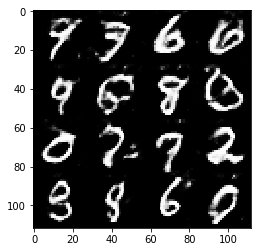

Epoch 2/2... Avg. Discriminator Loss: 1.2065... Avg. Generator Loss: 0.9726


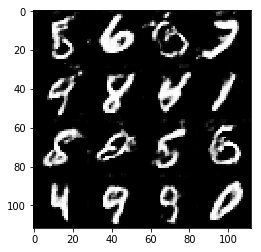

Epoch 2/2... Avg. Discriminator Loss: 1.3050... Avg. Generator Loss: 0.9277


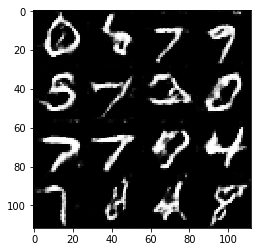

Epoch 2/2... Avg. Discriminator Loss: 1.2906... Avg. Generator Loss: 0.9597


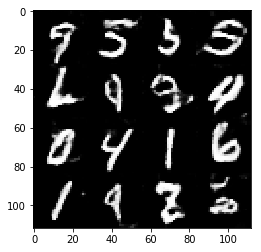

Epoch 2/2... Avg. Discriminator Loss: 1.3132... Avg. Generator Loss: 0.9043


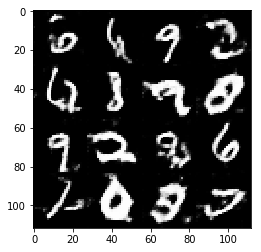

Epoch 2/2... Avg. Discriminator Loss: 1.2599... Avg. Generator Loss: 0.9193


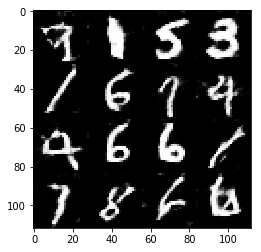

Epoch 2/2... Avg. Discriminator Loss: 1.2767... Avg. Generator Loss: 0.9477


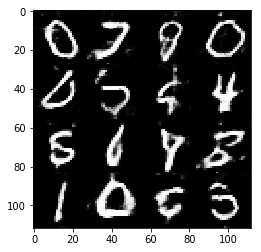

Epoch 2/2... Avg. Discriminator Loss: 1.3209... Avg. Generator Loss: 0.9369


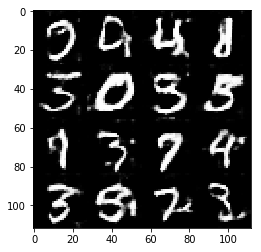

Epoch 2/2... Avg. Discriminator Loss: 1.2595... Avg. Generator Loss: 0.8609


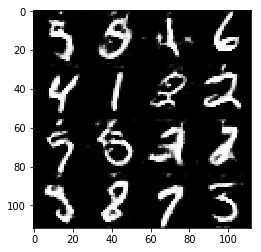

Epoch 2/2... Avg. Discriminator Loss: 1.2496... Avg. Generator Loss: 0.8682


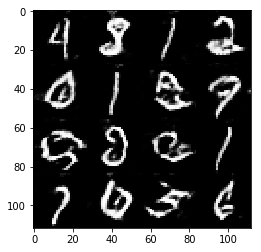

Epoch 2/2... Avg. Discriminator Loss: 1.3688... Avg. Generator Loss: 1.0633


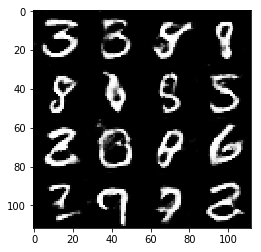

Epoch 2/2... Avg. Discriminator Loss: 1.3894... Avg. Generator Loss: 0.8486


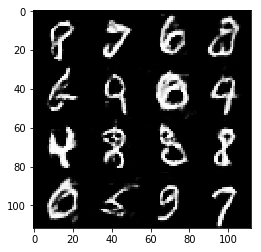

Epoch 2/2... Avg. Discriminator Loss: 1.3832... Avg. Generator Loss: 0.9259


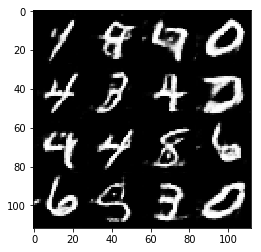

Epoch 2/2... Avg. Discriminator Loss: 1.2519... Avg. Generator Loss: 0.8659


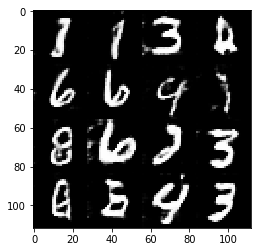

Epoch 2/2... Avg. Discriminator Loss: 1.3166... Avg. Generator Loss: 0.9332


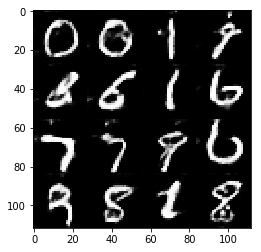

Epoch 2/2... Avg. Discriminator Loss: 1.3414... Avg. Generator Loss: 0.9548


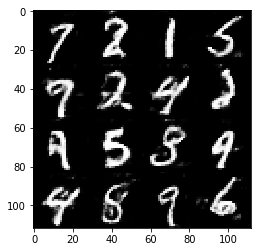

Epoch 2/2... Avg. Discriminator Loss: 1.2974... Avg. Generator Loss: 0.8222


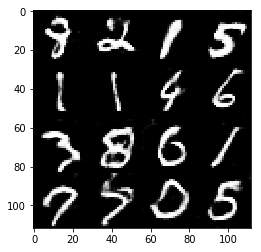

Epoch 2/2... Avg. Discriminator Loss: 1.3257... Avg. Generator Loss: 0.9168


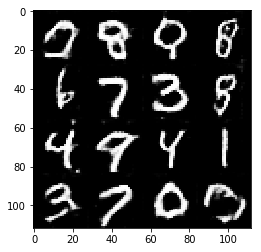

Epoch 2/2... Avg. Discriminator Loss: 1.3180... Avg. Generator Loss: 0.8559


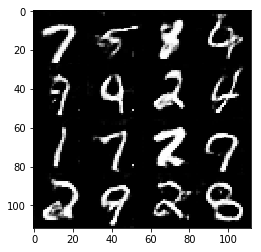

Epoch 2/2... Avg. Discriminator Loss: 1.3579... Avg. Generator Loss: 0.8801


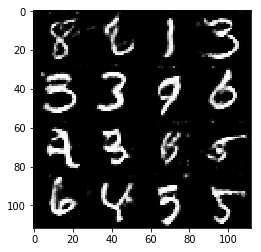

Epoch 2/2... Avg. Discriminator Loss: 1.3013... Avg. Generator Loss: 0.9499


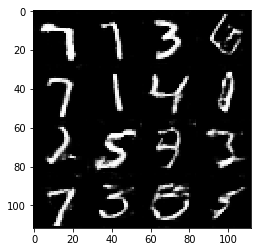

Epoch 2/2... Avg. Discriminator Loss: 1.3828... Avg. Generator Loss: 0.8430


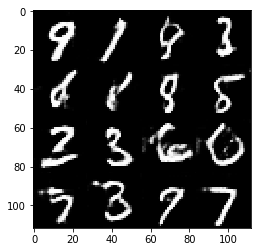

Epoch 2/2... Avg. Discriminator Loss: 1.3207... Avg. Generator Loss: 0.8536


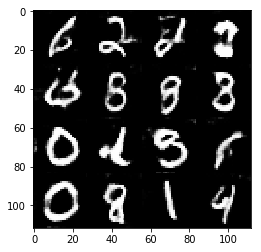

Epoch 2/2... Avg. Discriminator Loss: 1.3634... Avg. Generator Loss: 0.9754


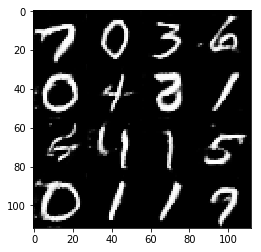

Epoch 2/2... Avg. Discriminator Loss: 1.4065... Avg. Generator Loss: 0.9566


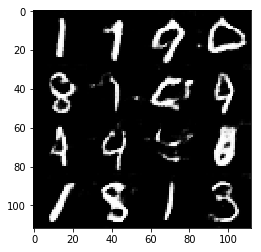

Epoch 2/2... Avg. Discriminator Loss: 1.2858... Avg. Generator Loss: 0.8406


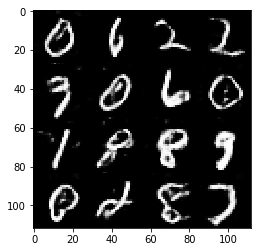

Epoch 2/2... Avg. Discriminator Loss: 1.3206... Avg. Generator Loss: 0.9089


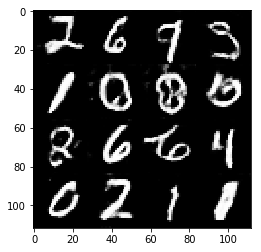

Epoch 2/2... Avg. Discriminator Loss: 1.1627... Avg. Generator Loss: 0.9861


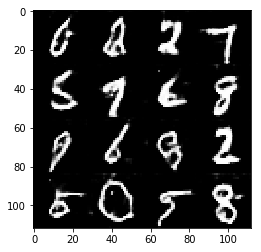

Epoch 2/2... Avg. Discriminator Loss: 1.3114... Avg. Generator Loss: 0.9291


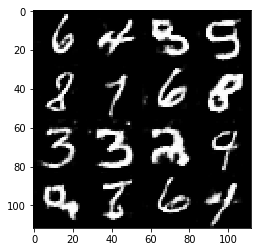

Epoch 2/2... Avg. Discriminator Loss: 1.3876... Avg. Generator Loss: 0.7869


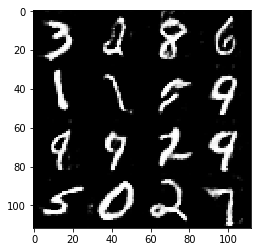

Epoch 2/2... Avg. Discriminator Loss: 1.3160... Avg. Generator Loss: 0.9116


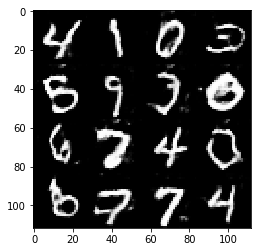

Epoch 2/2... Avg. Discriminator Loss: 1.3364... Avg. Generator Loss: 1.0293


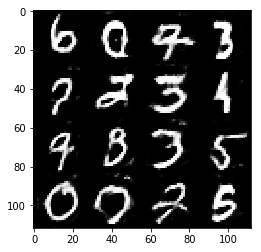

Epoch 2/2... Avg. Discriminator Loss: 1.2740... Avg. Generator Loss: 0.8176


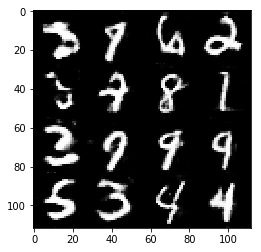

Epoch 2/2... Avg. Discriminator Loss: 1.2760... Avg. Generator Loss: 0.9914


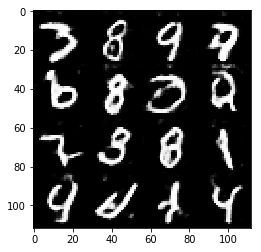

Epoch 2/2... Avg. Discriminator Loss: 1.2799... Avg. Generator Loss: 0.8187


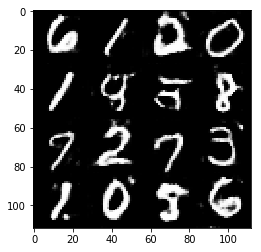

Epoch 2/2... Avg. Discriminator Loss: 1.3631... Avg. Generator Loss: 0.8976


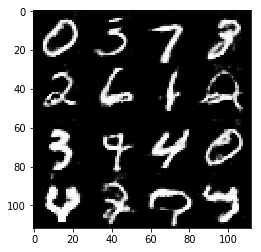

Epoch 2/2... Avg. Discriminator Loss: 1.5181... Avg. Generator Loss: 0.8057


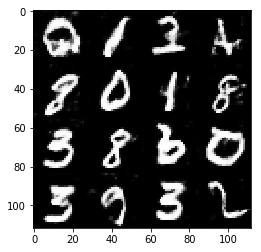

Epoch 2/2... Avg. Discriminator Loss: 1.3228... Avg. Generator Loss: 0.9220


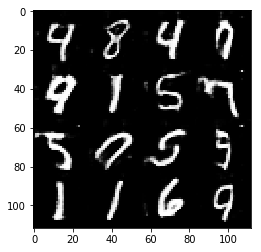

Epoch 2/2... Avg. Discriminator Loss: 1.3797... Avg. Generator Loss: 0.8350


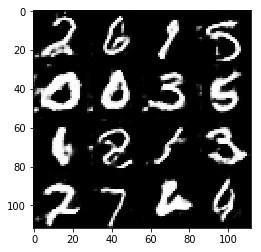

Epoch 2/2... Avg. Discriminator Loss: 1.3024... Avg. Generator Loss: 1.0109


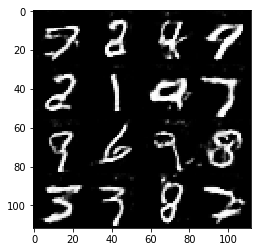

Epoch 2/2... Avg. Discriminator Loss: 1.3506... Avg. Generator Loss: 0.8660


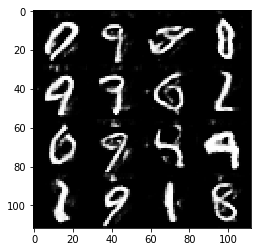

Epoch 2/2... Avg. Discriminator Loss: 1.2495... Avg. Generator Loss: 0.9777


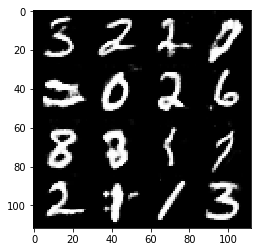

Epoch 2/2... Avg. Discriminator Loss: 1.2425... Avg. Generator Loss: 0.8820


In [ ]:
batch_size = 64
z_dim = 100
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

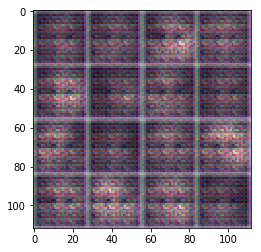

Epoch 1/1... Avg. Discriminator Loss: 2.5516... Avg. Generator Loss: 3.3581


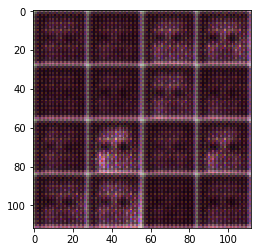

Epoch 1/1... Avg. Discriminator Loss: 0.9620... Avg. Generator Loss: 2.0801


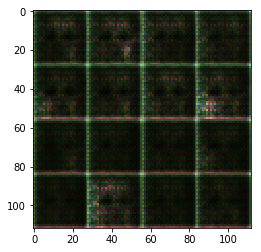

Epoch 1/1... Avg. Discriminator Loss: 1.2759... Avg. Generator Loss: 1.7604


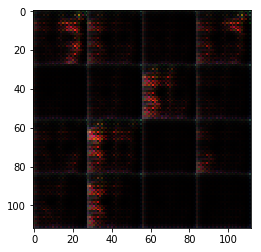

Epoch 1/1... Avg. Discriminator Loss: 1.3564... Avg. Generator Loss: 1.7182


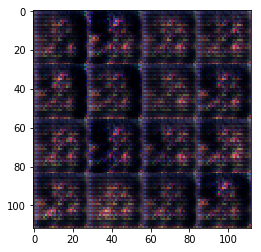

Epoch 1/1... Avg. Discriminator Loss: 1.1435... Avg. Generator Loss: 1.3152


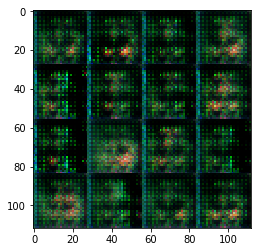

Epoch 1/1... Avg. Discriminator Loss: 1.1652... Avg. Generator Loss: 1.7257


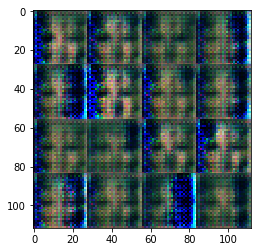

Epoch 1/1... Avg. Discriminator Loss: 1.0125... Avg. Generator Loss: 1.3626


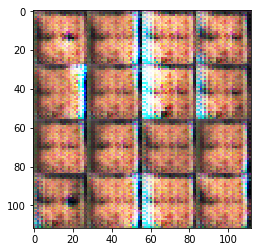

Epoch 1/1... Avg. Discriminator Loss: 1.3369... Avg. Generator Loss: 1.6433


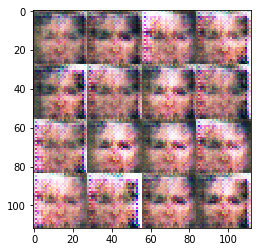

Epoch 1/1... Avg. Discriminator Loss: 1.2382... Avg. Generator Loss: 1.3871


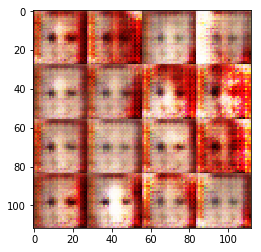

Epoch 1/1... Avg. Discriminator Loss: 1.2777... Avg. Generator Loss: 1.2180


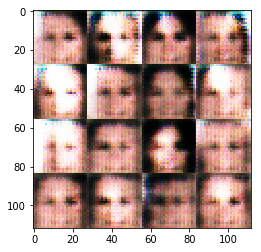

Epoch 1/1... Avg. Discriminator Loss: 1.3237... Avg. Generator Loss: 1.1462


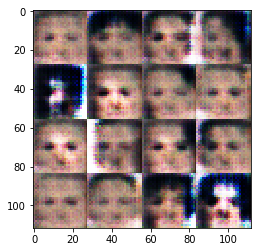

Epoch 1/1... Avg. Discriminator Loss: 1.4064... Avg. Generator Loss: 0.9200


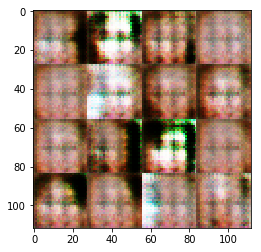

Epoch 1/1... Avg. Discriminator Loss: 1.2582... Avg. Generator Loss: 1.0649


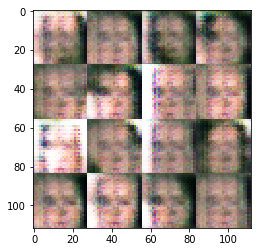

Epoch 1/1... Avg. Discriminator Loss: 1.2407... Avg. Generator Loss: 1.0663


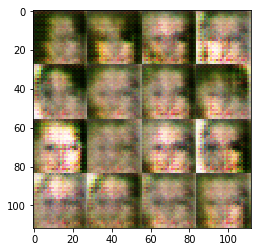

Epoch 1/1... Avg. Discriminator Loss: 1.3417... Avg. Generator Loss: 0.9254


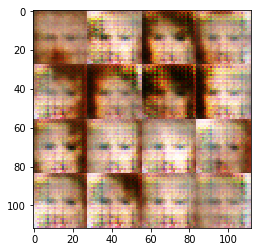

Epoch 1/1... Avg. Discriminator Loss: 1.2041... Avg. Generator Loss: 1.0334


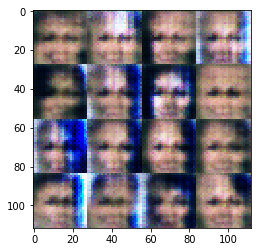

Epoch 1/1... Avg. Discriminator Loss: 1.2201... Avg. Generator Loss: 1.1141


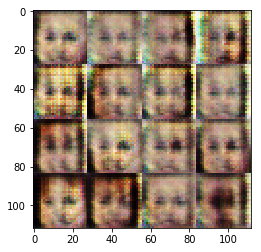

Epoch 1/1... Avg. Discriminator Loss: 1.2813... Avg. Generator Loss: 1.0752


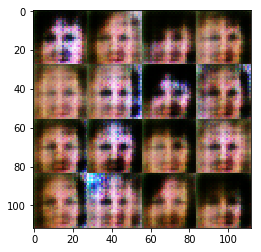

Epoch 1/1... Avg. Discriminator Loss: 1.2889... Avg. Generator Loss: 0.9961


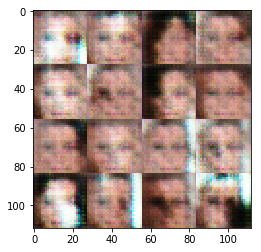

Epoch 1/1... Avg. Discriminator Loss: 1.2331... Avg. Generator Loss: 1.0539


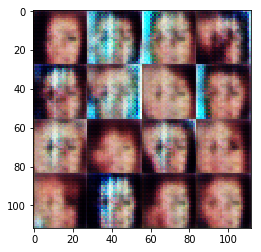

Epoch 1/1... Avg. Discriminator Loss: 1.2684... Avg. Generator Loss: 0.9838


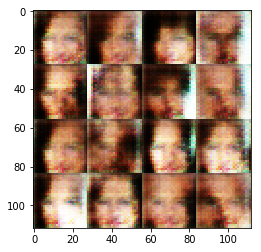

Epoch 1/1... Avg. Discriminator Loss: 1.1300... Avg. Generator Loss: 1.1832


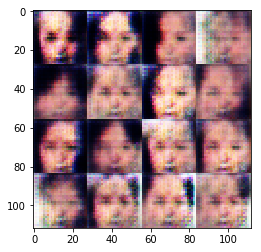

Epoch 1/1... Avg. Discriminator Loss: 1.2245... Avg. Generator Loss: 1.2522


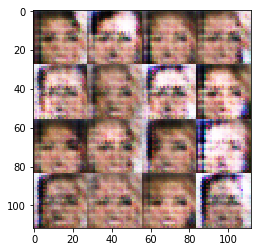

Epoch 1/1... Avg. Discriminator Loss: 1.1917... Avg. Generator Loss: 1.1443


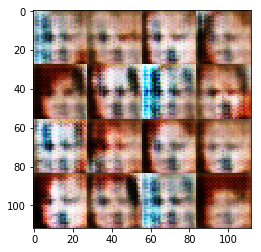

Epoch 1/1... Avg. Discriminator Loss: 1.2928... Avg. Generator Loss: 1.1835


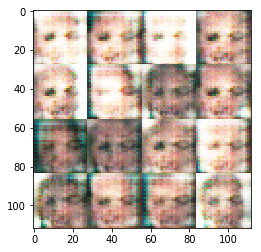

Epoch 1/1... Avg. Discriminator Loss: 1.1590... Avg. Generator Loss: 1.1360


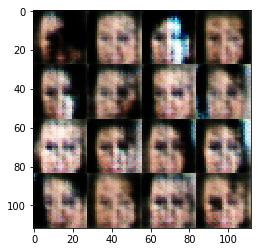

Epoch 1/1... Avg. Discriminator Loss: 1.2734... Avg. Generator Loss: 1.1978


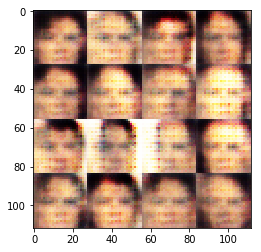

Epoch 1/1... Avg. Discriminator Loss: 1.1651... Avg. Generator Loss: 1.1019


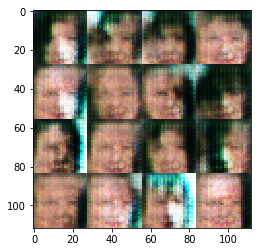

Epoch 1/1... Avg. Discriminator Loss: 1.3589... Avg. Generator Loss: 1.0252


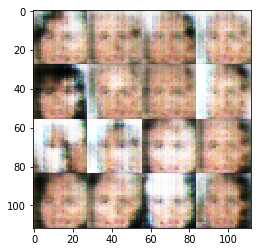

Epoch 1/1... Avg. Discriminator Loss: 1.1671... Avg. Generator Loss: 1.1660


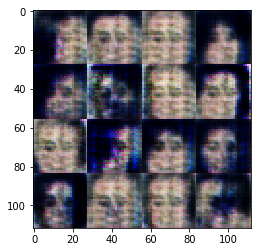

Epoch 1/1... Avg. Discriminator Loss: 1.0995... Avg. Generator Loss: 1.3200


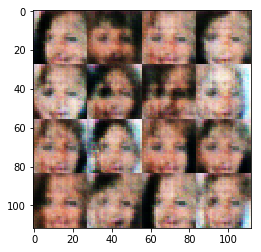

Epoch 1/1... Avg. Discriminator Loss: 1.1860... Avg. Generator Loss: 1.3335


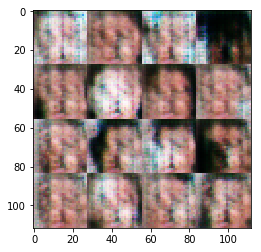

Epoch 1/1... Avg. Discriminator Loss: 1.0991... Avg. Generator Loss: 1.0612


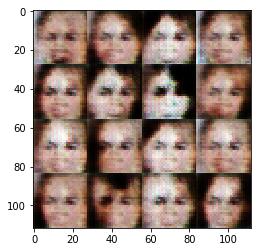

Epoch 1/1... Avg. Discriminator Loss: 1.1190... Avg. Generator Loss: 1.2909


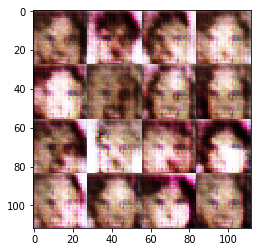

Epoch 1/1... Avg. Discriminator Loss: 1.1952... Avg. Generator Loss: 1.1056


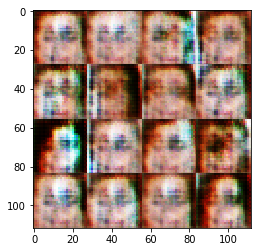

Epoch 1/1... Avg. Discriminator Loss: 1.1338... Avg. Generator Loss: 1.3281


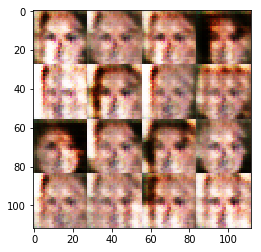

Epoch 1/1... Avg. Discriminator Loss: 1.0477... Avg. Generator Loss: 1.4548


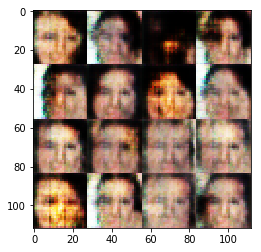

Epoch 1/1... Avg. Discriminator Loss: 1.1622... Avg. Generator Loss: 1.7861


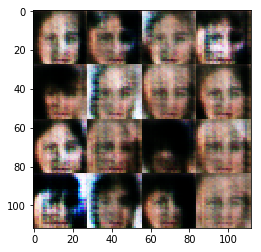

Epoch 1/1... Avg. Discriminator Loss: 1.1463... Avg. Generator Loss: 1.2960


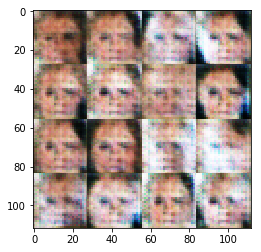

Epoch 1/1... Avg. Discriminator Loss: 1.2963... Avg. Generator Loss: 1.1454


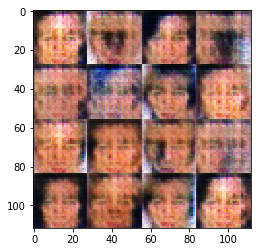

Epoch 1/1... Avg. Discriminator Loss: 1.1878... Avg. Generator Loss: 1.1147


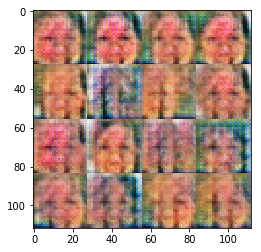

Epoch 1/1... Avg. Discriminator Loss: 1.3539... Avg. Generator Loss: 1.1385


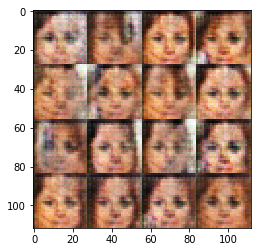

Epoch 1/1... Avg. Discriminator Loss: 1.2130... Avg. Generator Loss: 1.1925


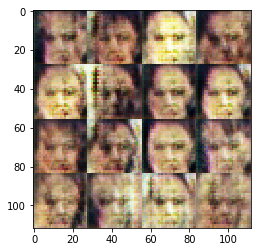

Epoch 1/1... Avg. Discriminator Loss: 1.2852... Avg. Generator Loss: 1.1744


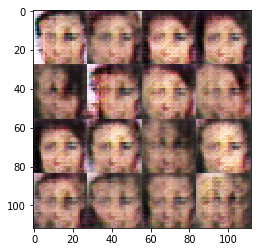

Epoch 1/1... Avg. Discriminator Loss: 1.1357... Avg. Generator Loss: 1.0472


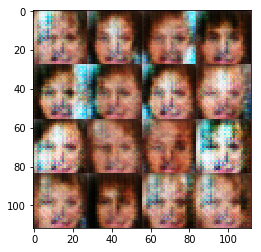

Epoch 1/1... Avg. Discriminator Loss: 1.2837... Avg. Generator Loss: 1.3901


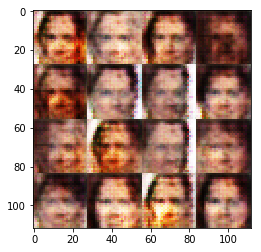

Epoch 1/1... Avg. Discriminator Loss: 1.1810... Avg. Generator Loss: 1.3275


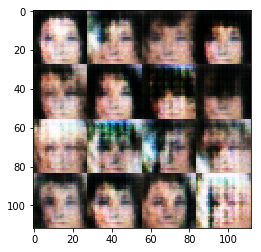

Epoch 1/1... Avg. Discriminator Loss: 1.2087... Avg. Generator Loss: 1.2066


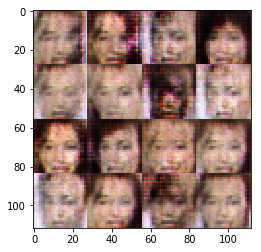

Epoch 1/1... Avg. Discriminator Loss: 1.0524... Avg. Generator Loss: 1.1968


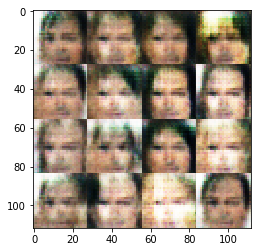

Epoch 1/1... Avg. Discriminator Loss: 1.2389... Avg. Generator Loss: 1.0258


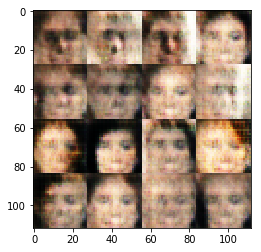

Epoch 1/1... Avg. Discriminator Loss: 1.2192... Avg. Generator Loss: 1.1188


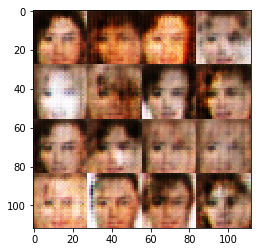

Epoch 1/1... Avg. Discriminator Loss: 1.3872... Avg. Generator Loss: 0.9435


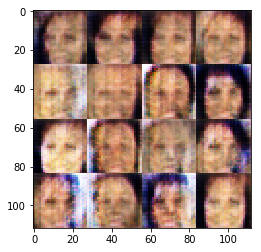

Epoch 1/1... Avg. Discriminator Loss: 1.1694... Avg. Generator Loss: 1.1358


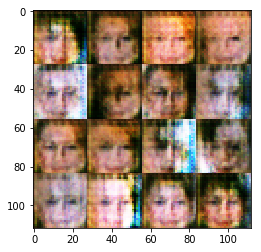

Epoch 1/1... Avg. Discriminator Loss: 1.3909... Avg. Generator Loss: 1.0832


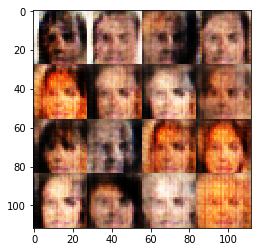

Epoch 1/1... Avg. Discriminator Loss: 1.2768... Avg. Generator Loss: 1.2481


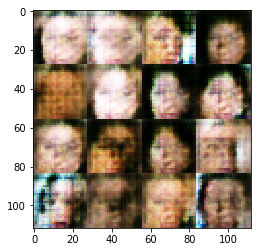

Epoch 1/1... Avg. Discriminator Loss: 1.1078... Avg. Generator Loss: 1.1663


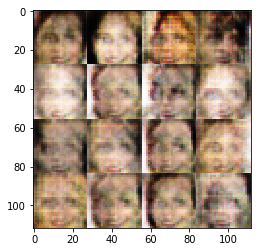

Epoch 1/1... Avg. Discriminator Loss: 1.1451... Avg. Generator Loss: 1.2695


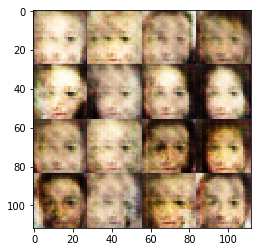

Epoch 1/1... Avg. Discriminator Loss: 1.1832... Avg. Generator Loss: 1.1726


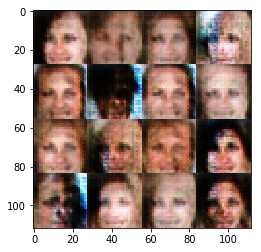

Epoch 1/1... Avg. Discriminator Loss: 1.2129... Avg. Generator Loss: 1.1429


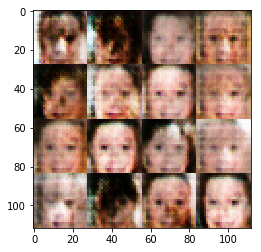

Epoch 1/1... Avg. Discriminator Loss: 1.1803... Avg. Generator Loss: 1.2484


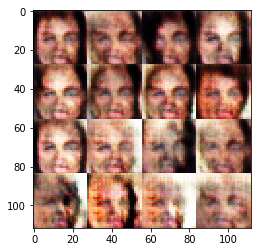

Epoch 1/1... Avg. Discriminator Loss: 1.0807... Avg. Generator Loss: 1.1349


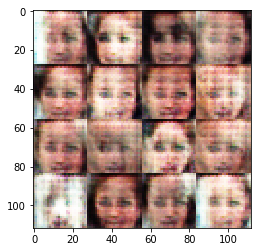

Epoch 1/1... Avg. Discriminator Loss: 1.3183... Avg. Generator Loss: 1.3995


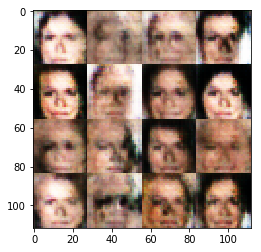

Epoch 1/1... Avg. Discriminator Loss: 1.0431... Avg. Generator Loss: 1.0732


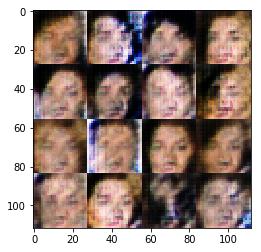

Epoch 1/1... Avg. Discriminator Loss: 1.1520... Avg. Generator Loss: 1.1526


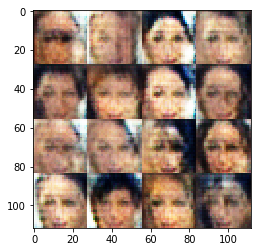

Epoch 1/1... Avg. Discriminator Loss: 1.2509... Avg. Generator Loss: 1.3203


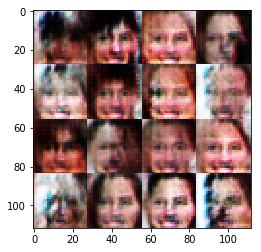

Epoch 1/1... Avg. Discriminator Loss: 1.1331... Avg. Generator Loss: 1.4041


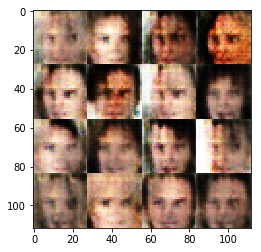

Epoch 1/1... Avg. Discriminator Loss: 1.1060... Avg. Generator Loss: 1.1654


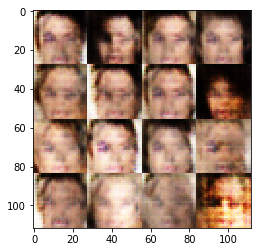

Epoch 1/1... Avg. Discriminator Loss: 1.2961... Avg. Generator Loss: 1.4860


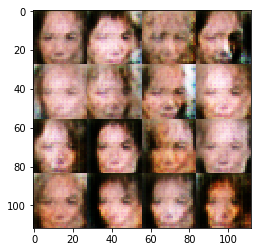

Epoch 1/1... Avg. Discriminator Loss: 1.0715... Avg. Generator Loss: 1.3800


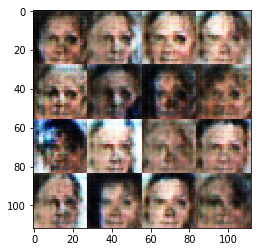

Epoch 1/1... Avg. Discriminator Loss: 1.0507... Avg. Generator Loss: 1.3653


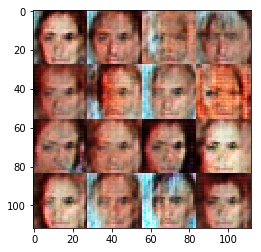

Epoch 1/1... Avg. Discriminator Loss: 1.1001... Avg. Generator Loss: 1.2327


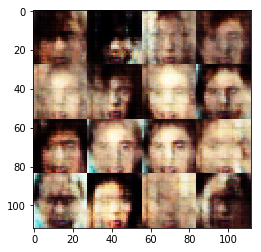

Epoch 1/1... Avg. Discriminator Loss: 1.1220... Avg. Generator Loss: 1.4068


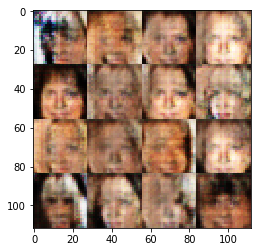

Epoch 1/1... Avg. Discriminator Loss: 1.1380... Avg. Generator Loss: 1.1821


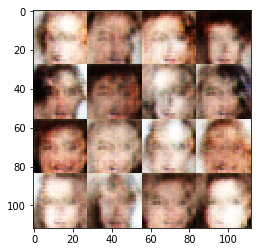

Epoch 1/1... Avg. Discriminator Loss: 1.1031... Avg. Generator Loss: 1.4066


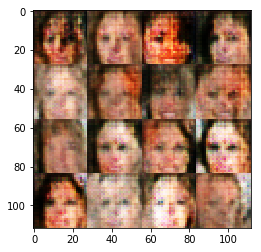

Epoch 1/1... Avg. Discriminator Loss: 1.0922... Avg. Generator Loss: 1.3287


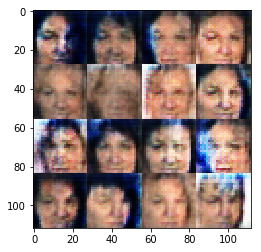

Epoch 1/1... Avg. Discriminator Loss: 1.0606... Avg. Generator Loss: 1.2160


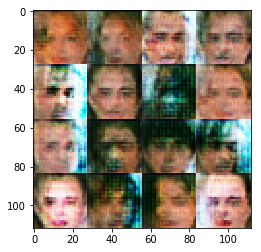

Epoch 1/1... Avg. Discriminator Loss: 1.1344... Avg. Generator Loss: 1.2763


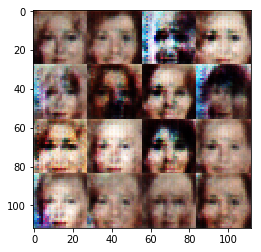

Epoch 1/1... Avg. Discriminator Loss: 1.2149... Avg. Generator Loss: 1.2409


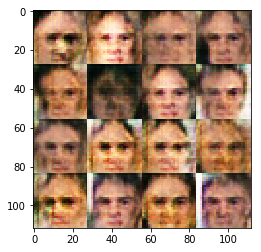

Epoch 1/1... Avg. Discriminator Loss: 1.1004... Avg. Generator Loss: 1.2443


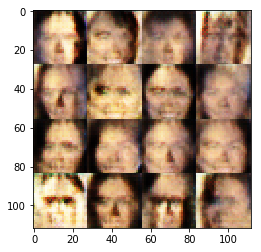

Epoch 1/1... Avg. Discriminator Loss: 1.1565... Avg. Generator Loss: 1.2470


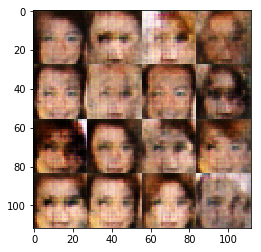

Epoch 1/1... Avg. Discriminator Loss: 1.0283... Avg. Generator Loss: 1.2161


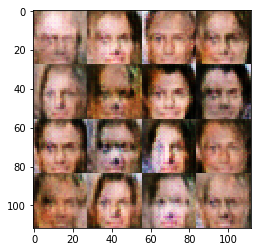

Epoch 1/1... Avg. Discriminator Loss: 1.0011... Avg. Generator Loss: 1.4914


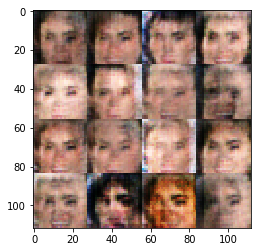

Epoch 1/1... Avg. Discriminator Loss: 1.1635... Avg. Generator Loss: 1.3788


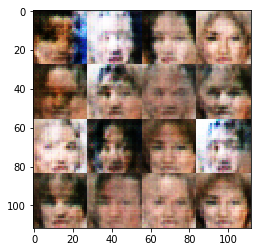

Epoch 1/1... Avg. Discriminator Loss: 1.1555... Avg. Generator Loss: 0.9927


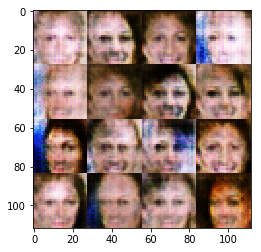

Epoch 1/1... Avg. Discriminator Loss: 1.0894... Avg. Generator Loss: 1.1640


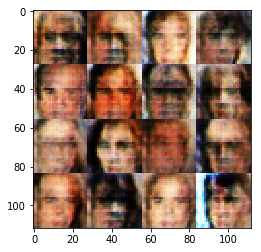

Epoch 1/1... Avg. Discriminator Loss: 1.0544... Avg. Generator Loss: 1.4300


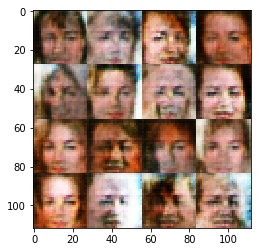

Epoch 1/1... Avg. Discriminator Loss: 1.0982... Avg. Generator Loss: 1.3473


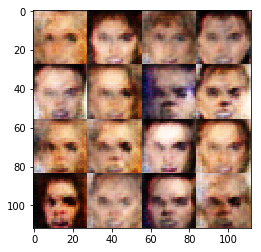

Epoch 1/1... Avg. Discriminator Loss: 1.0988... Avg. Generator Loss: 1.1621


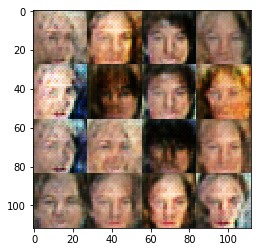

Epoch 1/1... Avg. Discriminator Loss: 1.1241... Avg. Generator Loss: 1.2534


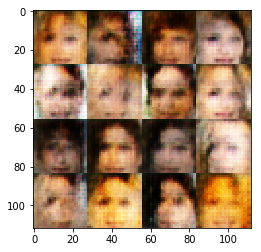

Epoch 1/1... Avg. Discriminator Loss: 1.0989... Avg. Generator Loss: 1.4073


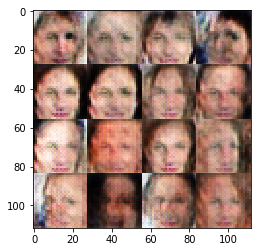

Epoch 1/1... Avg. Discriminator Loss: 1.1557... Avg. Generator Loss: 1.3579


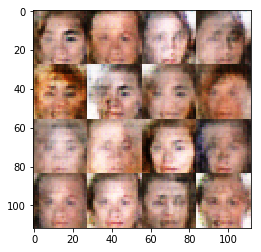

Epoch 1/1... Avg. Discriminator Loss: 1.1790... Avg. Generator Loss: 1.1770


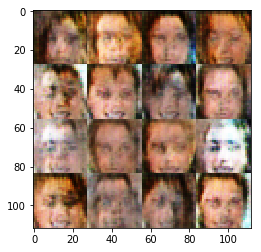

Epoch 1/1... Avg. Discriminator Loss: 1.1954... Avg. Generator Loss: 1.0856


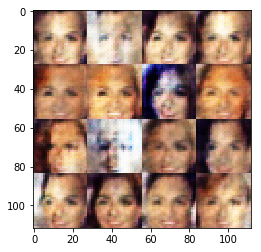

Epoch 1/1... Avg. Discriminator Loss: 1.1931... Avg. Generator Loss: 1.2236


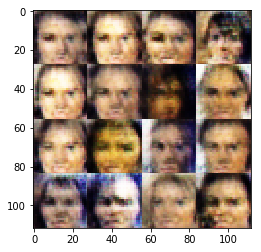

Epoch 1/1... Avg. Discriminator Loss: 1.2574... Avg. Generator Loss: 1.0512


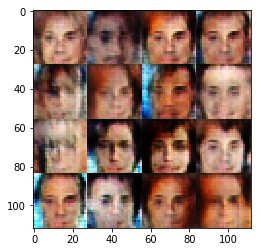

Epoch 1/1... Avg. Discriminator Loss: 1.1923... Avg. Generator Loss: 1.2790


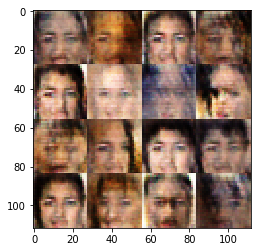

Epoch 1/1... Avg. Discriminator Loss: 1.0533... Avg. Generator Loss: 1.3043


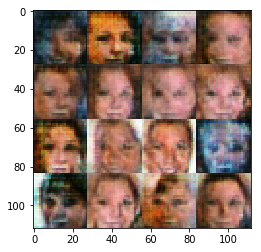

Epoch 1/1... Avg. Discriminator Loss: 1.1599... Avg. Generator Loss: 1.2404


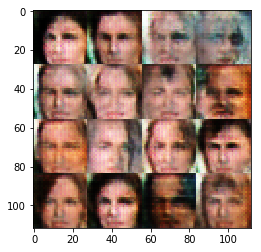

Epoch 1/1... Avg. Discriminator Loss: 1.1748... Avg. Generator Loss: 1.0846


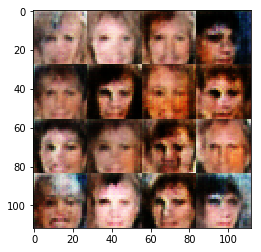

Epoch 1/1... Avg. Discriminator Loss: 1.1041... Avg. Generator Loss: 1.1491


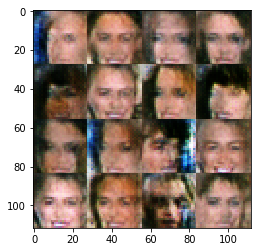

Epoch 1/1... Avg. Discriminator Loss: 1.1850... Avg. Generator Loss: 0.9988


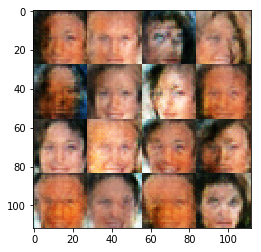

Epoch 1/1... Avg. Discriminator Loss: 1.1565... Avg. Generator Loss: 0.9708


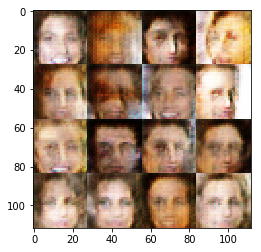

Epoch 1/1... Avg. Discriminator Loss: 1.1657... Avg. Generator Loss: 1.1519


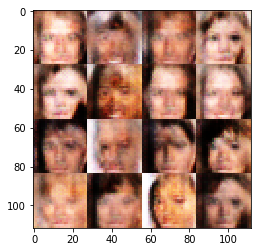

Epoch 1/1... Avg. Discriminator Loss: 1.2452... Avg. Generator Loss: 1.0952


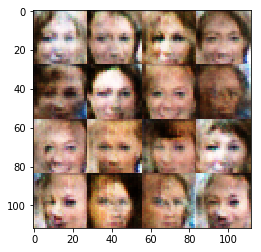

Epoch 1/1... Avg. Discriminator Loss: 1.1582... Avg. Generator Loss: 1.0931


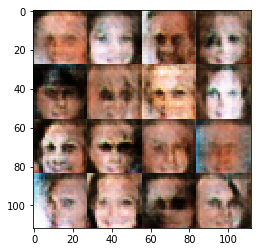

Epoch 1/1... Avg. Discriminator Loss: 1.1292... Avg. Generator Loss: 1.1428


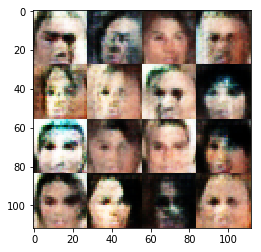

Epoch 1/1... Avg. Discriminator Loss: 1.1755... Avg. Generator Loss: 1.2434


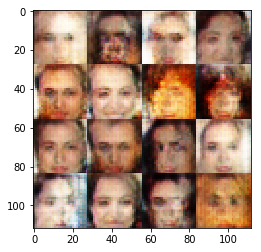

Epoch 1/1... Avg. Discriminator Loss: 1.2586... Avg. Generator Loss: 1.0859


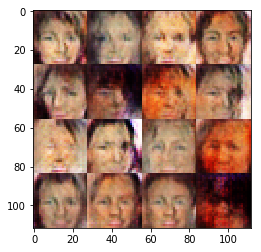

Epoch 1/1... Avg. Discriminator Loss: 1.0951... Avg. Generator Loss: 1.0907


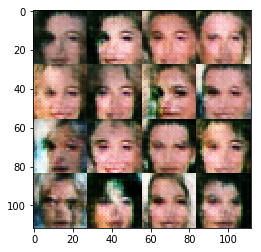

Epoch 1/1... Avg. Discriminator Loss: 1.1741... Avg. Generator Loss: 1.1221


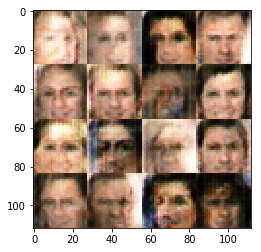

Epoch 1/1... Avg. Discriminator Loss: 1.1636... Avg. Generator Loss: 1.1769


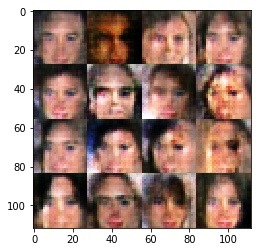

Epoch 1/1... Avg. Discriminator Loss: 1.2444... Avg. Generator Loss: 1.1202


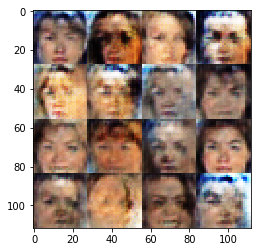

Epoch 1/1... Avg. Discriminator Loss: 1.1874... Avg. Generator Loss: 1.0935


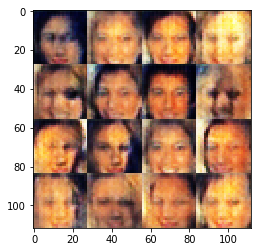

Epoch 1/1... Avg. Discriminator Loss: 1.0998... Avg. Generator Loss: 1.1836


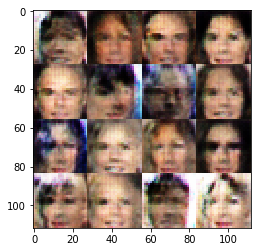

Epoch 1/1... Avg. Discriminator Loss: 1.1598... Avg. Generator Loss: 1.0971


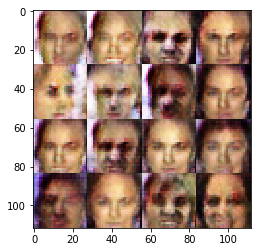

Epoch 1/1... Avg. Discriminator Loss: 1.0703... Avg. Generator Loss: 1.2249


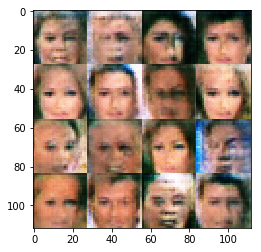

Epoch 1/1... Avg. Discriminator Loss: 1.0741... Avg. Generator Loss: 1.3131


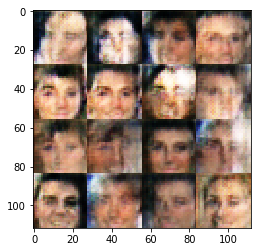

Epoch 1/1... Avg. Discriminator Loss: 1.1830... Avg. Generator Loss: 1.2361


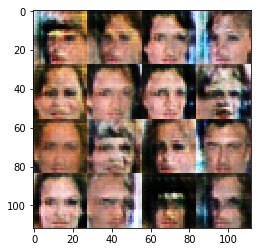

Epoch 1/1... Avg. Discriminator Loss: 1.1694... Avg. Generator Loss: 1.1673


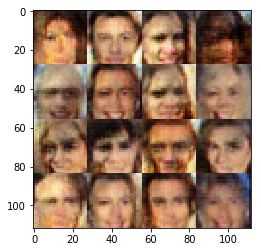

Epoch 1/1... Avg. Discriminator Loss: 1.1619... Avg. Generator Loss: 1.1651


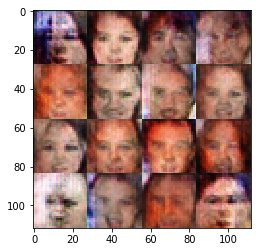

Epoch 1/1... Avg. Discriminator Loss: 1.1434... Avg. Generator Loss: 1.1567


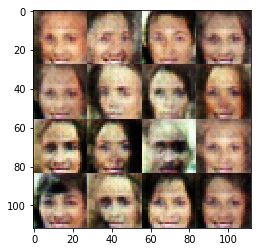

Epoch 1/1... Avg. Discriminator Loss: 1.1587... Avg. Generator Loss: 1.0744


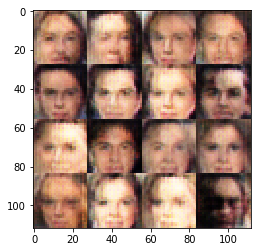

Epoch 1/1... Avg. Discriminator Loss: 1.1198... Avg. Generator Loss: 1.1221


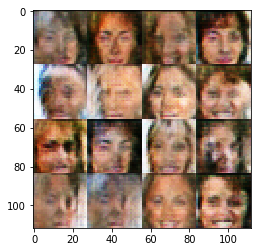

Epoch 1/1... Avg. Discriminator Loss: 1.3353... Avg. Generator Loss: 1.0445


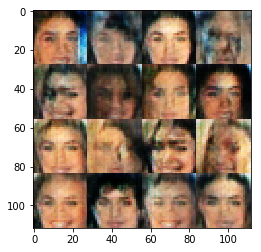

Epoch 1/1... Avg. Discriminator Loss: 1.0964... Avg. Generator Loss: 1.2586


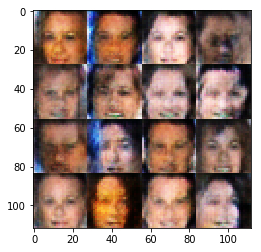

Epoch 1/1... Avg. Discriminator Loss: 1.1724... Avg. Generator Loss: 1.0768


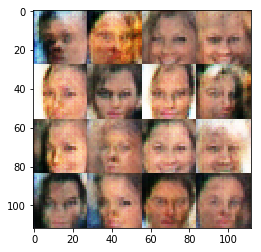

Epoch 1/1... Avg. Discriminator Loss: 1.1389... Avg. Generator Loss: 1.1251


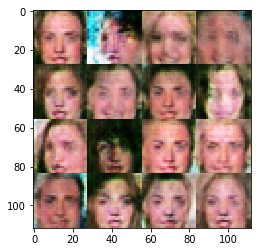

Epoch 1/1... Avg. Discriminator Loss: 1.0731... Avg. Generator Loss: 1.1078


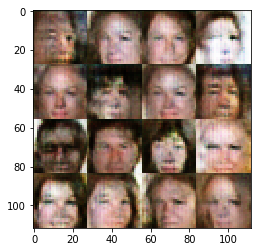

Epoch 1/1... Avg. Discriminator Loss: 1.2112... Avg. Generator Loss: 1.0764


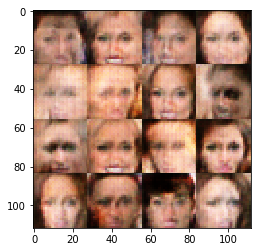

Epoch 1/1... Avg. Discriminator Loss: 1.0780... Avg. Generator Loss: 1.3041


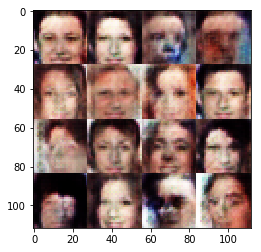

Epoch 1/1... Avg. Discriminator Loss: 1.1413... Avg. Generator Loss: 1.0524


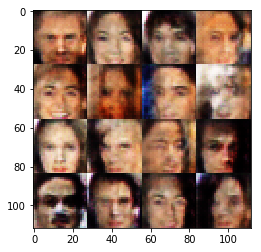

Epoch 1/1... Avg. Discriminator Loss: 1.1366... Avg. Generator Loss: 1.0404


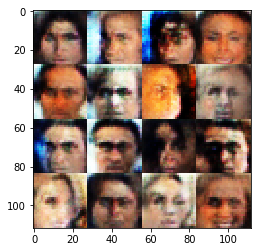

Epoch 1/1... Avg. Discriminator Loss: 1.1620... Avg. Generator Loss: 1.1512


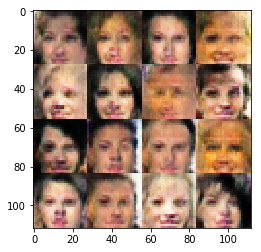

Epoch 1/1... Avg. Discriminator Loss: 1.0523... Avg. Generator Loss: 1.1040


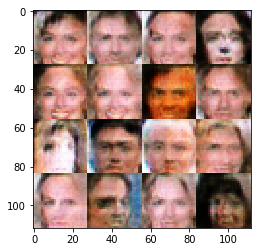

Epoch 1/1... Avg. Discriminator Loss: 1.2648... Avg. Generator Loss: 1.2156


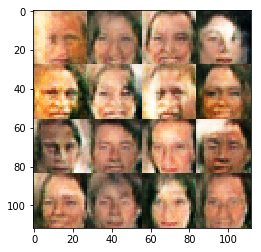

Epoch 1/1... Avg. Discriminator Loss: 1.1901... Avg. Generator Loss: 0.9883


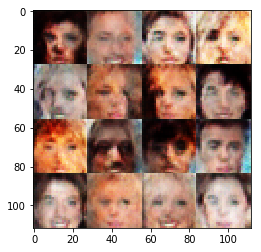

Epoch 1/1... Avg. Discriminator Loss: 1.2110... Avg. Generator Loss: 1.0049


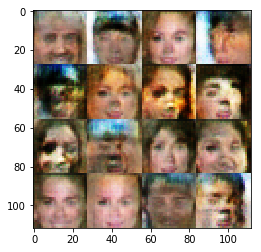

Epoch 1/1... Avg. Discriminator Loss: 1.1657... Avg. Generator Loss: 0.9851


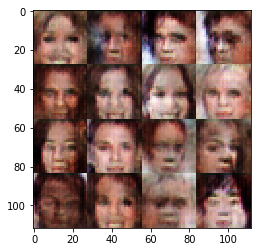

Epoch 1/1... Avg. Discriminator Loss: 1.1735... Avg. Generator Loss: 1.0648


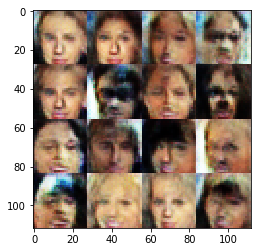

Epoch 1/1... Avg. Discriminator Loss: 1.1012... Avg. Generator Loss: 1.1085


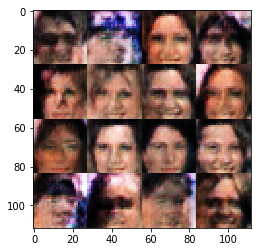

Epoch 1/1... Avg. Discriminator Loss: 1.2184... Avg. Generator Loss: 1.1887


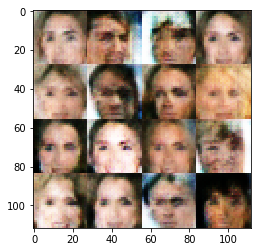

Epoch 1/1... Avg. Discriminator Loss: 1.1626... Avg. Generator Loss: 1.0242


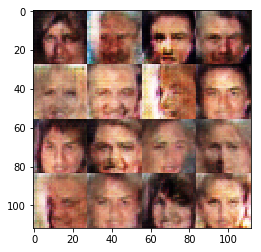

Epoch 1/1... Avg. Discriminator Loss: 1.2043... Avg. Generator Loss: 1.0767


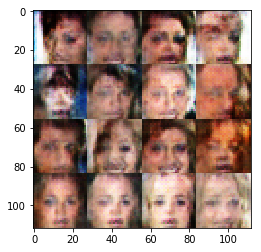

Epoch 1/1... Avg. Discriminator Loss: 1.1577... Avg. Generator Loss: 1.0302


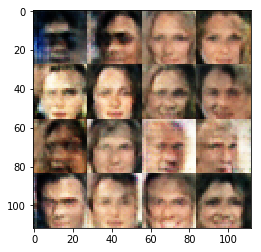

Epoch 1/1... Avg. Discriminator Loss: 1.2808... Avg. Generator Loss: 1.1795


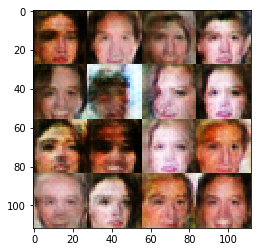

Epoch 1/1... Avg. Discriminator Loss: 1.1711... Avg. Generator Loss: 0.9985


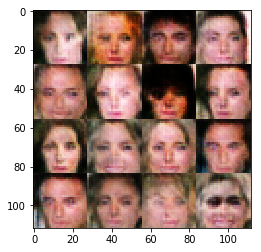

Epoch 1/1... Avg. Discriminator Loss: 1.2812... Avg. Generator Loss: 1.0320


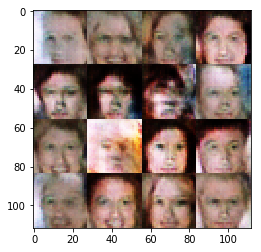

Epoch 1/1... Avg. Discriminator Loss: 1.1667... Avg. Generator Loss: 1.1221


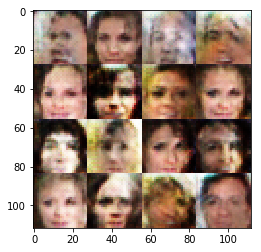

Epoch 1/1... Avg. Discriminator Loss: 1.1162... Avg. Generator Loss: 1.1898


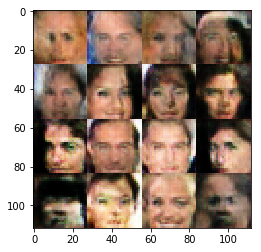

Epoch 1/1... Avg. Discriminator Loss: 1.1385... Avg. Generator Loss: 1.1189


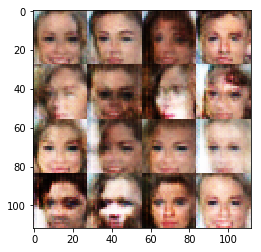

Epoch 1/1... Avg. Discriminator Loss: 1.1569... Avg. Generator Loss: 1.0008


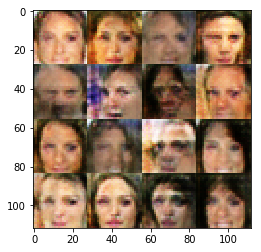

Epoch 1/1... Avg. Discriminator Loss: 1.2457... Avg. Generator Loss: 1.0536


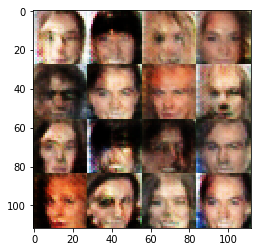

Epoch 1/1... Avg. Discriminator Loss: 1.1914... Avg. Generator Loss: 0.9982


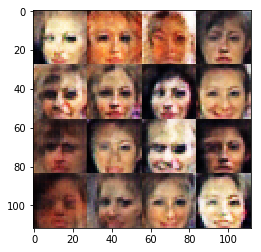

Epoch 1/1... Avg. Discriminator Loss: 1.1873... Avg. Generator Loss: 1.1230


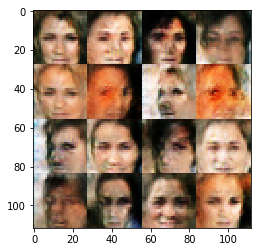

Epoch 1/1... Avg. Discriminator Loss: 1.1114... Avg. Generator Loss: 1.0691


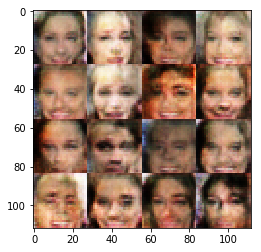

Epoch 1/1... Avg. Discriminator Loss: 1.2030... Avg. Generator Loss: 1.1301


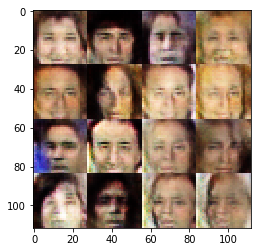

Epoch 1/1... Avg. Discriminator Loss: 1.0917... Avg. Generator Loss: 1.1928


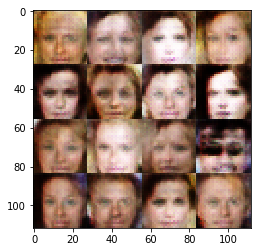

Epoch 1/1... Avg. Discriminator Loss: 1.1555... Avg. Generator Loss: 1.1054


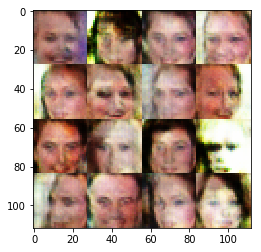

Epoch 1/1... Avg. Discriminator Loss: 1.1654... Avg. Generator Loss: 1.0719


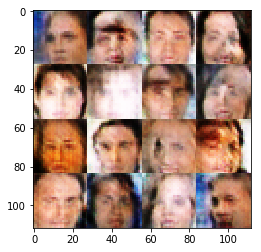

Epoch 1/1... Avg. Discriminator Loss: 1.0769... Avg. Generator Loss: 1.1192


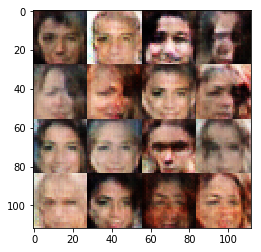

Epoch 1/1... Avg. Discriminator Loss: 1.0680... Avg. Generator Loss: 1.1057


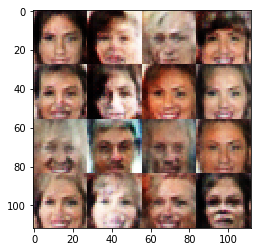

Epoch 1/1... Avg. Discriminator Loss: 1.2384... Avg. Generator Loss: 1.0493


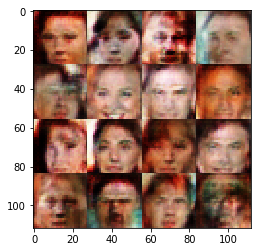

Epoch 1/1... Avg. Discriminator Loss: 1.1290... Avg. Generator Loss: 1.1186


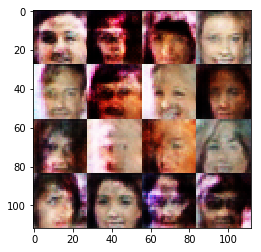

Epoch 1/1... Avg. Discriminator Loss: 1.1736... Avg. Generator Loss: 1.0627


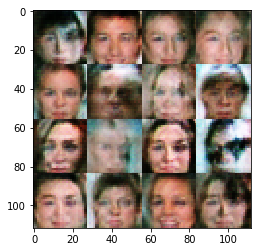

Epoch 1/1... Avg. Discriminator Loss: 1.1578... Avg. Generator Loss: 1.1327


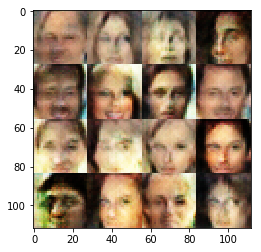

Epoch 1/1... Avg. Discriminator Loss: 1.1372... Avg. Generator Loss: 1.0699


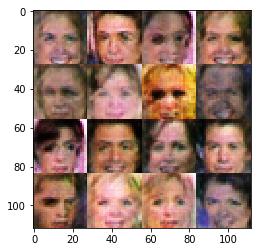

Epoch 1/1... Avg. Discriminator Loss: 1.1848... Avg. Generator Loss: 0.9749


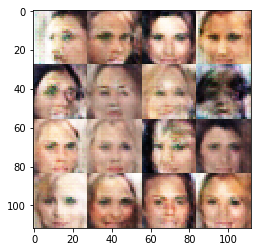

Epoch 1/1... Avg. Discriminator Loss: 1.1886... Avg. Generator Loss: 0.9552


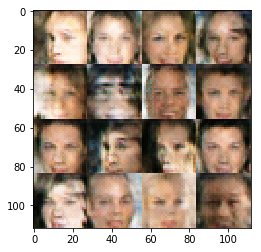

Epoch 1/1... Avg. Discriminator Loss: 1.2239... Avg. Generator Loss: 0.9368


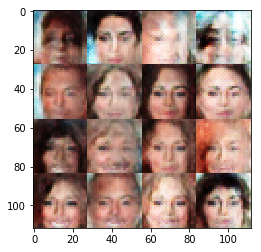

Epoch 1/1... Avg. Discriminator Loss: 1.2331... Avg. Generator Loss: 1.0150


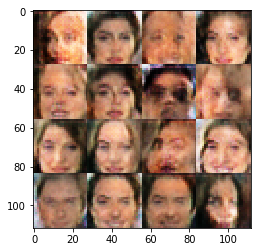

Epoch 1/1... Avg. Discriminator Loss: 1.1492... Avg. Generator Loss: 1.1132


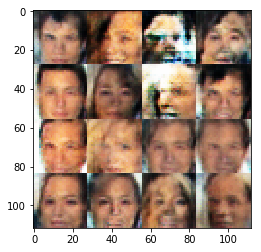

Epoch 1/1... Avg. Discriminator Loss: 1.2264... Avg. Generator Loss: 0.9624


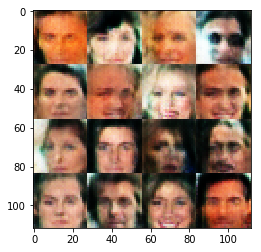

Epoch 1/1... Avg. Discriminator Loss: 1.0954... Avg. Generator Loss: 0.9916


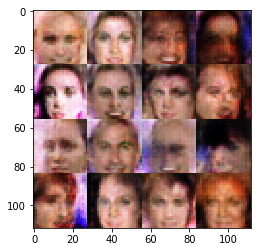

Epoch 1/1... Avg. Discriminator Loss: 1.1927... Avg. Generator Loss: 0.8902


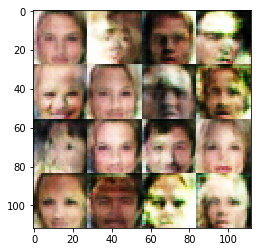

Epoch 1/1... Avg. Discriminator Loss: 1.1118... Avg. Generator Loss: 1.0258


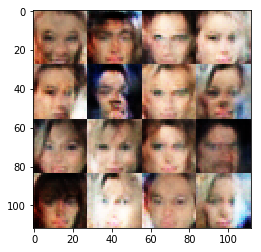

Epoch 1/1... Avg. Discriminator Loss: 1.2276... Avg. Generator Loss: 0.9702


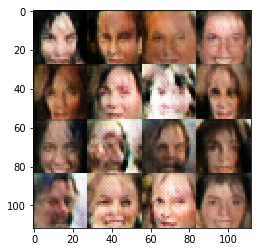

Epoch 1/1... Avg. Discriminator Loss: 1.1452... Avg. Generator Loss: 1.1088


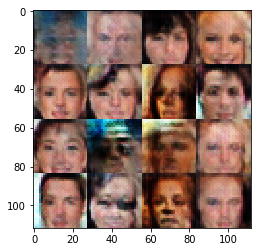

Epoch 1/1... Avg. Discriminator Loss: 1.0985... Avg. Generator Loss: 1.0566


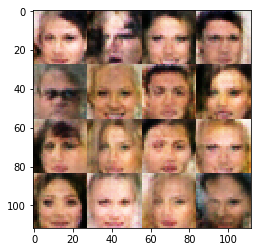

Epoch 1/1... Avg. Discriminator Loss: 1.2597... Avg. Generator Loss: 1.0770


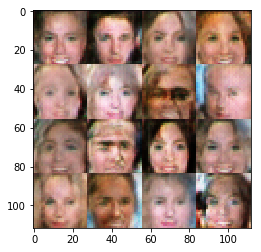

Epoch 1/1... Avg. Discriminator Loss: 1.1526... Avg. Generator Loss: 1.0192


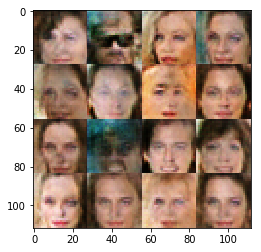

Epoch 1/1... Avg. Discriminator Loss: 1.1111... Avg. Generator Loss: 1.0054


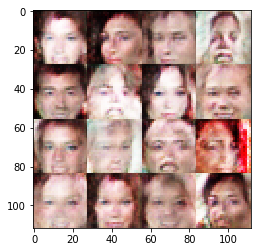

Epoch 1/1... Avg. Discriminator Loss: 1.1938... Avg. Generator Loss: 0.9196


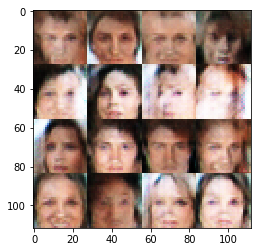

Epoch 1/1... Avg. Discriminator Loss: 1.3101... Avg. Generator Loss: 1.0479


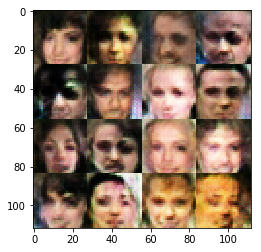

Epoch 1/1... Avg. Discriminator Loss: 1.2130... Avg. Generator Loss: 0.9391


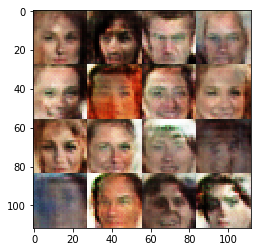

Epoch 1/1... Avg. Discriminator Loss: 1.1648... Avg. Generator Loss: 0.9782


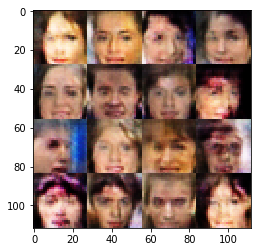

Epoch 1/1... Avg. Discriminator Loss: 1.1880... Avg. Generator Loss: 1.0709


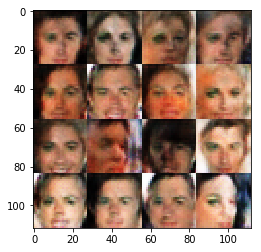

Epoch 1/1... Avg. Discriminator Loss: 1.1644... Avg. Generator Loss: 0.9537


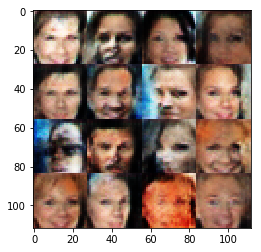

Epoch 1/1... Avg. Discriminator Loss: 1.2234... Avg. Generator Loss: 0.9555


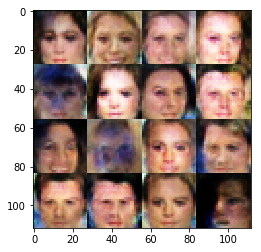

Epoch 1/1... Avg. Discriminator Loss: 1.2215... Avg. Generator Loss: 0.9237


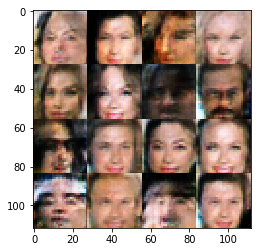

Epoch 1/1... Avg. Discriminator Loss: 1.1929... Avg. Generator Loss: 0.9988


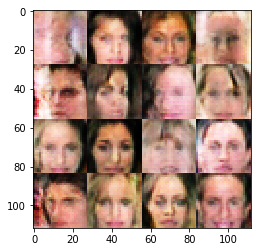

Epoch 1/1... Avg. Discriminator Loss: 1.1835... Avg. Generator Loss: 0.9218


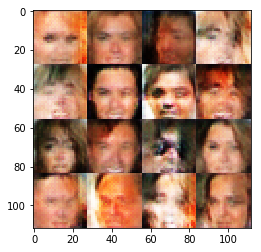

Epoch 1/1... Avg. Discriminator Loss: 1.2837... Avg. Generator Loss: 0.9143


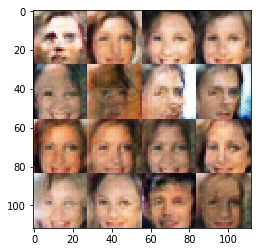

Epoch 1/1... Avg. Discriminator Loss: 1.1628... Avg. Generator Loss: 1.0628


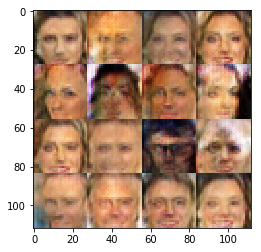

Epoch 1/1... Avg. Discriminator Loss: 1.1560... Avg. Generator Loss: 0.9551


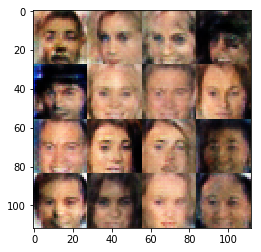

Epoch 1/1... Avg. Discriminator Loss: 1.2306... Avg. Generator Loss: 0.9046


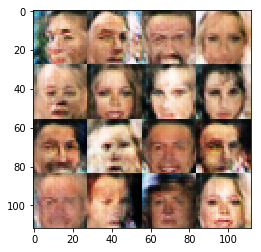

Epoch 1/1... Avg. Discriminator Loss: 1.1677... Avg. Generator Loss: 0.9791


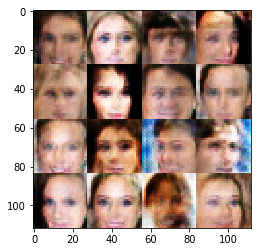

Epoch 1/1... Avg. Discriminator Loss: 1.2116... Avg. Generator Loss: 0.9159


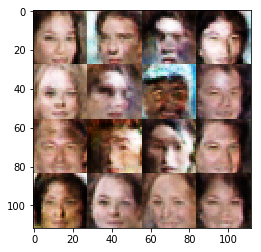

Epoch 1/1... Avg. Discriminator Loss: 1.2487... Avg. Generator Loss: 0.9516


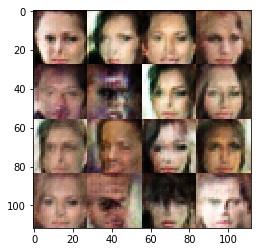

Epoch 1/1... Avg. Discriminator Loss: 1.1773... Avg. Generator Loss: 0.9370


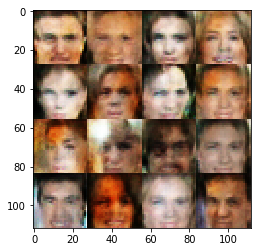

Epoch 1/1... Avg. Discriminator Loss: 1.2702... Avg. Generator Loss: 0.9596


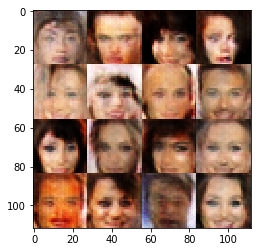

Epoch 1/1... Avg. Discriminator Loss: 1.1209... Avg. Generator Loss: 1.0515


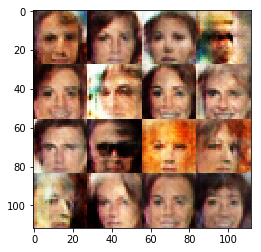

Epoch 1/1... Avg. Discriminator Loss: 1.1637... Avg. Generator Loss: 0.9941


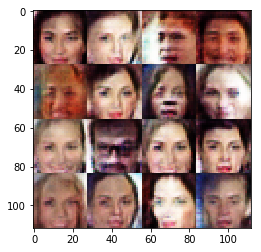

Epoch 1/1... Avg. Discriminator Loss: 1.2350... Avg. Generator Loss: 1.1036


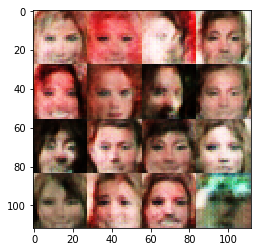

Epoch 1/1... Avg. Discriminator Loss: 1.1352... Avg. Generator Loss: 1.0480


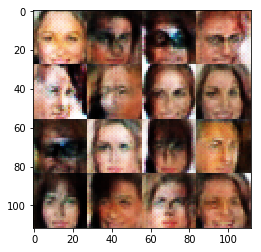

Epoch 1/1... Avg. Discriminator Loss: 1.1368... Avg. Generator Loss: 1.0355


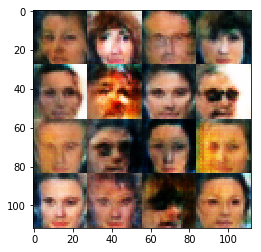

Epoch 1/1... Avg. Discriminator Loss: 1.2387... Avg. Generator Loss: 1.1131


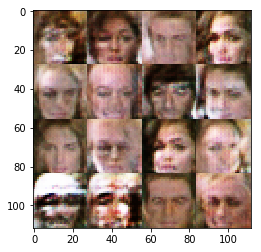

Epoch 1/1... Avg. Discriminator Loss: 1.2214... Avg. Generator Loss: 0.9789


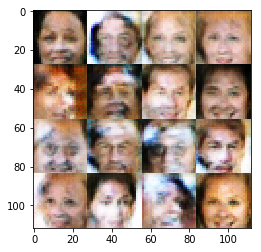

Epoch 1/1... Avg. Discriminator Loss: 1.2053... Avg. Generator Loss: 1.1391


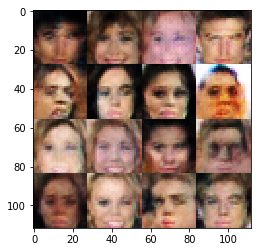

Epoch 1/1... Avg. Discriminator Loss: 1.1219... Avg. Generator Loss: 1.1411


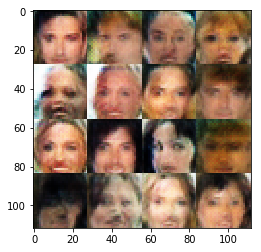

Epoch 1/1... Avg. Discriminator Loss: 1.2849... Avg. Generator Loss: 0.9462


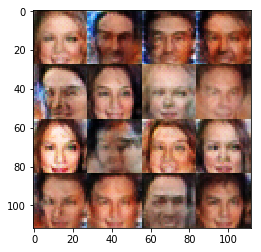

Epoch 1/1... Avg. Discriminator Loss: 1.1439... Avg. Generator Loss: 1.1175


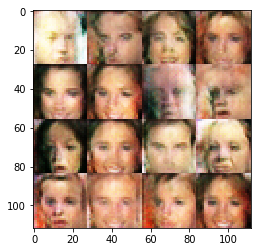

Epoch 1/1... Avg. Discriminator Loss: 1.1006... Avg. Generator Loss: 1.0117


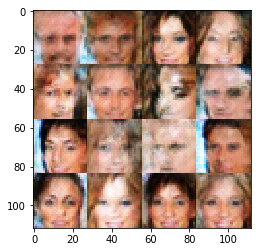

Epoch 1/1... Avg. Discriminator Loss: 1.1452... Avg. Generator Loss: 1.1855


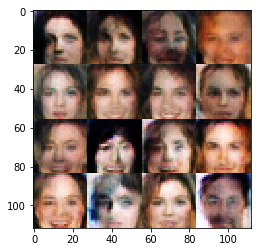

Epoch 1/1... Avg. Discriminator Loss: 1.2016... Avg. Generator Loss: 1.0555


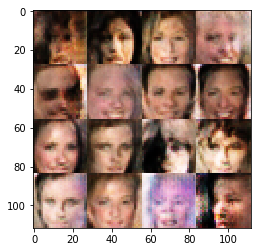

Epoch 1/1... Avg. Discriminator Loss: 1.0667... Avg. Generator Loss: 1.1179


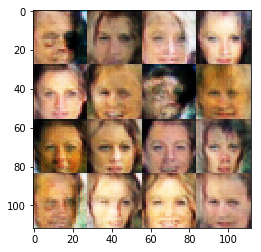

Epoch 1/1... Avg. Discriminator Loss: 1.2549... Avg. Generator Loss: 0.9742


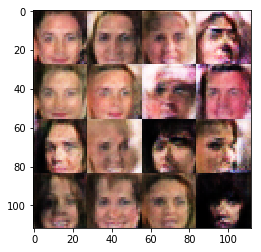

Epoch 1/1... Avg. Discriminator Loss: 1.2424... Avg. Generator Loss: 1.0202


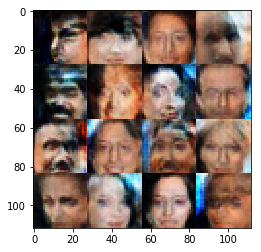

Epoch 1/1... Avg. Discriminator Loss: 1.1175... Avg. Generator Loss: 1.1227


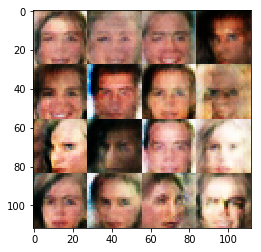

Epoch 1/1... Avg. Discriminator Loss: 1.2911... Avg. Generator Loss: 1.2044


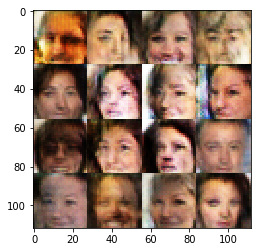

Epoch 1/1... Avg. Discriminator Loss: 1.2873... Avg. Generator Loss: 0.9599


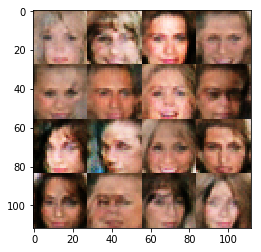

Epoch 1/1... Avg. Discriminator Loss: 1.1943... Avg. Generator Loss: 0.9292


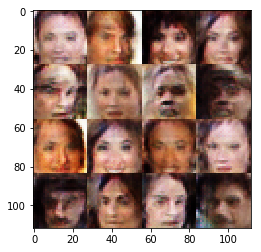

Epoch 1/1... Avg. Discriminator Loss: 1.2320... Avg. Generator Loss: 0.8414


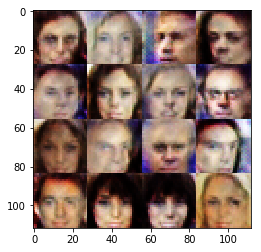

Epoch 1/1... Avg. Discriminator Loss: 1.1969... Avg. Generator Loss: 0.9436


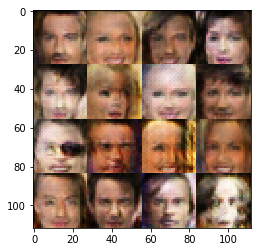

Epoch 1/1... Avg. Discriminator Loss: 1.2065... Avg. Generator Loss: 0.9978


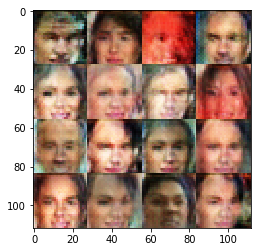

Epoch 1/1... Avg. Discriminator Loss: 1.0914... Avg. Generator Loss: 1.0335


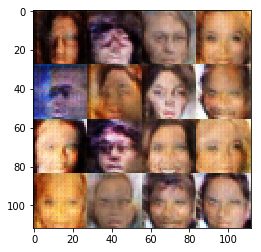

Epoch 1/1... Avg. Discriminator Loss: 1.0731... Avg. Generator Loss: 1.1876


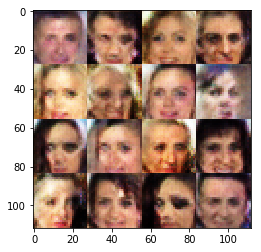

Epoch 1/1... Avg. Discriminator Loss: 1.1747... Avg. Generator Loss: 1.0825


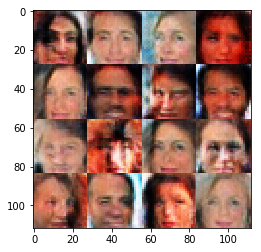

Epoch 1/1... Avg. Discriminator Loss: 1.1017... Avg. Generator Loss: 1.0987


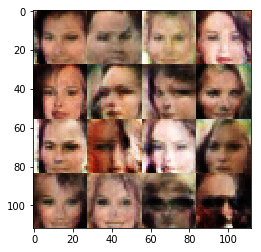

Epoch 1/1... Avg. Discriminator Loss: 1.2137... Avg. Generator Loss: 0.9388


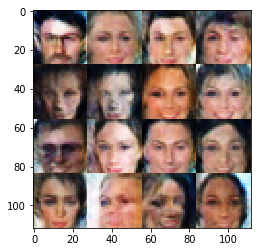

Epoch 1/1... Avg. Discriminator Loss: 1.1170... Avg. Generator Loss: 1.1126


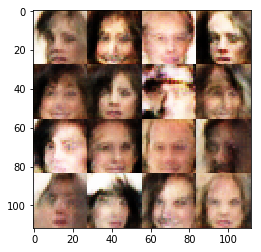

Epoch 1/1... Avg. Discriminator Loss: 1.2150... Avg. Generator Loss: 0.9543


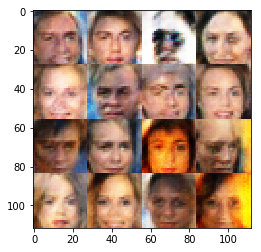

Epoch 1/1... Avg. Discriminator Loss: 1.2764... Avg. Generator Loss: 0.8299


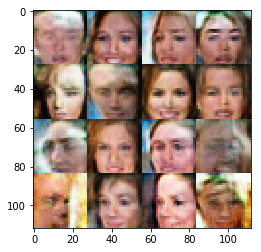

Epoch 1/1... Avg. Discriminator Loss: 1.1464... Avg. Generator Loss: 1.0034


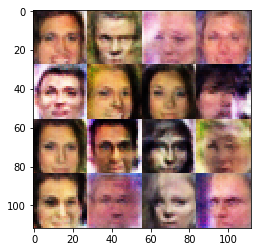

Epoch 1/1... Avg. Discriminator Loss: 1.1530... Avg. Generator Loss: 1.0144


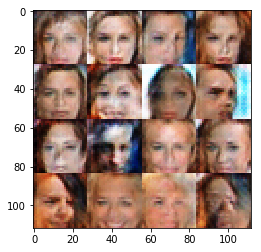

Epoch 1/1... Avg. Discriminator Loss: 1.2342... Avg. Generator Loss: 1.0043


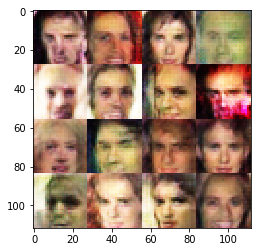

Epoch 1/1... Avg. Discriminator Loss: 1.1975... Avg. Generator Loss: 0.9649


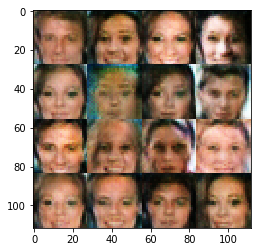

Epoch 1/1... Avg. Discriminator Loss: 1.2731... Avg. Generator Loss: 1.0426


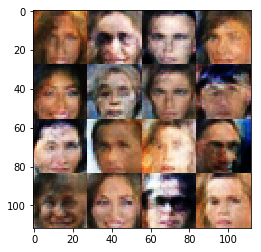

Epoch 1/1... Avg. Discriminator Loss: 1.1412... Avg. Generator Loss: 1.0138


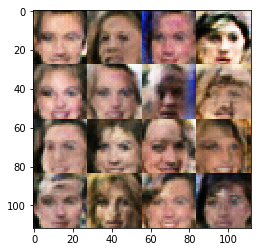

Epoch 1/1... Avg. Discriminator Loss: 1.1999... Avg. Generator Loss: 0.8468


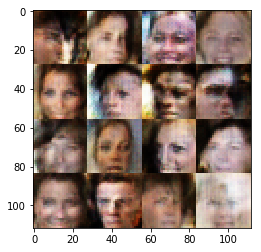

Epoch 1/1... Avg. Discriminator Loss: 1.1451... Avg. Generator Loss: 1.0805


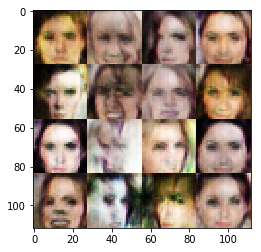

Epoch 1/1... Avg. Discriminator Loss: 1.2340... Avg. Generator Loss: 0.8942


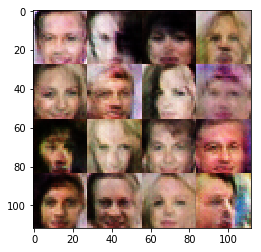

Epoch 1/1... Avg. Discriminator Loss: 1.2575... Avg. Generator Loss: 0.9136


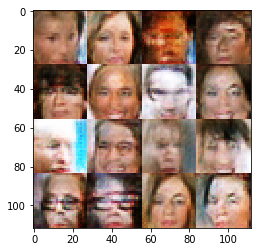

Epoch 1/1... Avg. Discriminator Loss: 1.2574... Avg. Generator Loss: 0.9704


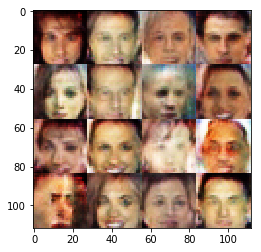

Epoch 1/1... Avg. Discriminator Loss: 1.1488... Avg. Generator Loss: 0.9284


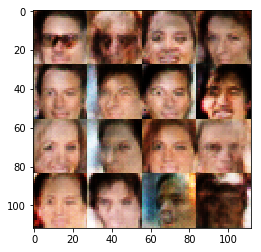

Epoch 1/1... Avg. Discriminator Loss: 1.2031... Avg. Generator Loss: 0.9977


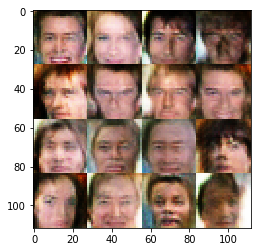

Epoch 1/1... Avg. Discriminator Loss: 1.1580... Avg. Generator Loss: 0.9813


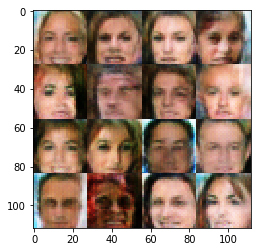

Epoch 1/1... Avg. Discriminator Loss: 1.1568... Avg. Generator Loss: 1.0154


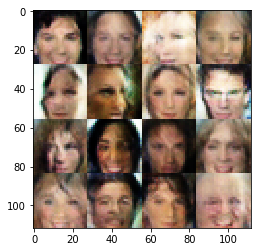

Epoch 1/1... Avg. Discriminator Loss: 1.2329... Avg. Generator Loss: 0.9327


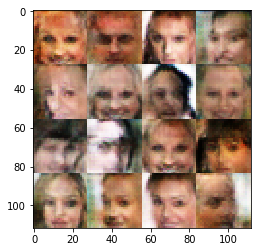

Epoch 1/1... Avg. Discriminator Loss: 1.2455... Avg. Generator Loss: 0.9519


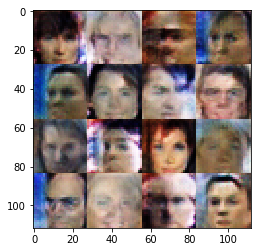

Epoch 1/1... Avg. Discriminator Loss: 1.2334... Avg. Generator Loss: 0.8921


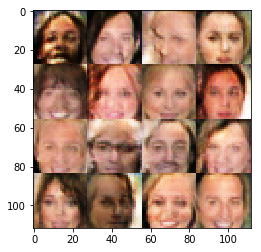

Epoch 1/1... Avg. Discriminator Loss: 1.2178... Avg. Generator Loss: 0.9406


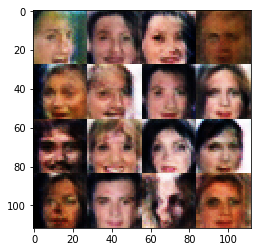

Epoch 1/1... Avg. Discriminator Loss: 1.1201... Avg. Generator Loss: 1.0670


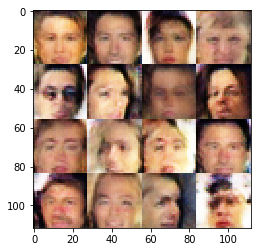

Epoch 1/1... Avg. Discriminator Loss: 1.2215... Avg. Generator Loss: 0.9102


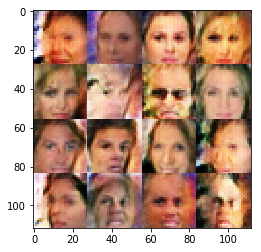

Epoch 1/1... Avg. Discriminator Loss: 1.1321... Avg. Generator Loss: 1.0125


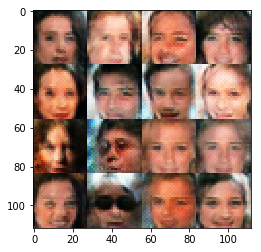

Epoch 1/1... Avg. Discriminator Loss: 1.2509... Avg. Generator Loss: 0.9055


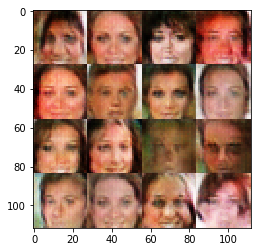

Epoch 1/1... Avg. Discriminator Loss: 1.2711... Avg. Generator Loss: 0.8677


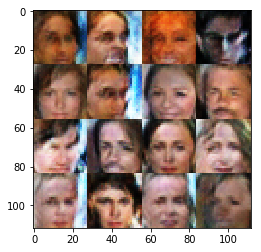

Epoch 1/1... Avg. Discriminator Loss: 1.1978... Avg. Generator Loss: 1.0005


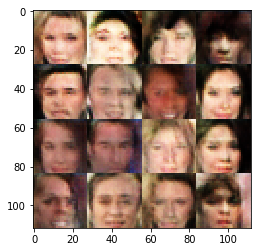

Epoch 1/1... Avg. Discriminator Loss: 1.4025... Avg. Generator Loss: 0.7568


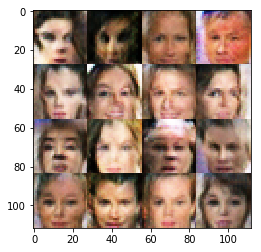

Epoch 1/1... Avg. Discriminator Loss: 1.1548... Avg. Generator Loss: 1.0146


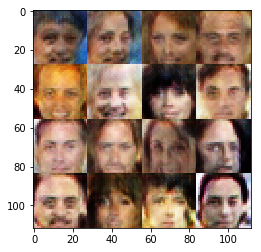

Epoch 1/1... Avg. Discriminator Loss: 1.2664... Avg. Generator Loss: 0.8664


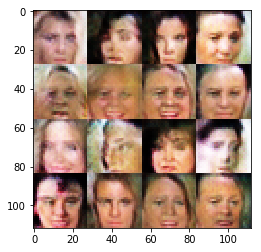

Epoch 1/1... Avg. Discriminator Loss: 1.2898... Avg. Generator Loss: 0.8728


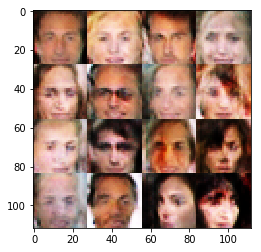

Epoch 1/1... Avg. Discriminator Loss: 1.1861... Avg. Generator Loss: 0.9574


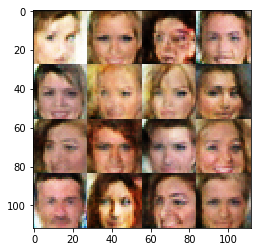

Epoch 1/1... Avg. Discriminator Loss: 1.2651... Avg. Generator Loss: 0.9751


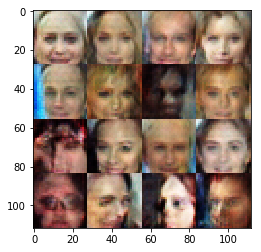

Epoch 1/1... Avg. Discriminator Loss: 1.2318... Avg. Generator Loss: 0.9424


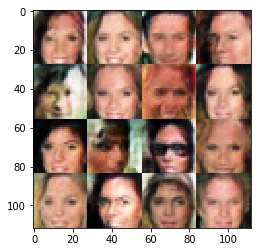

Epoch 1/1... Avg. Discriminator Loss: 1.1886... Avg. Generator Loss: 0.8381


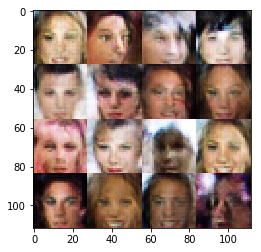

Epoch 1/1... Avg. Discriminator Loss: 1.2067... Avg. Generator Loss: 0.9189


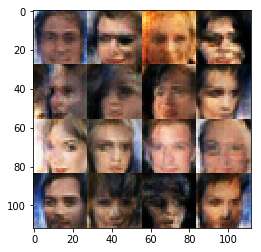

Epoch 1/1... Avg. Discriminator Loss: 1.2845... Avg. Generator Loss: 0.9555


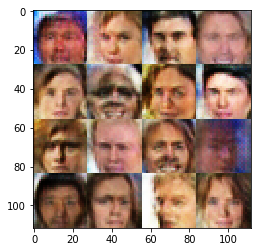

Epoch 1/1... Avg. Discriminator Loss: 1.2005... Avg. Generator Loss: 1.0073


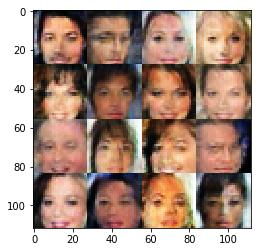

Epoch 1/1... Avg. Discriminator Loss: 1.1829... Avg. Generator Loss: 0.9747


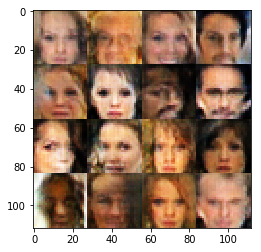

Epoch 1/1... Avg. Discriminator Loss: 1.1926... Avg. Generator Loss: 1.0480


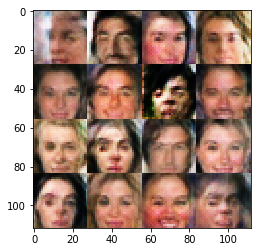

Epoch 1/1... Avg. Discriminator Loss: 1.1686... Avg. Generator Loss: 0.9401


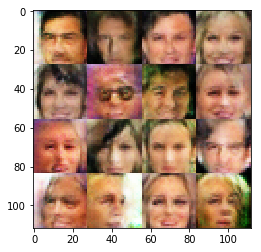

Epoch 1/1... Avg. Discriminator Loss: 1.2399... Avg. Generator Loss: 0.9030


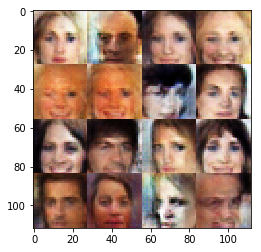

Epoch 1/1... Avg. Discriminator Loss: 1.1742... Avg. Generator Loss: 0.9518


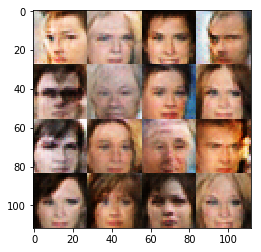

Epoch 1/1... Avg. Discriminator Loss: 1.2999... Avg. Generator Loss: 0.9291


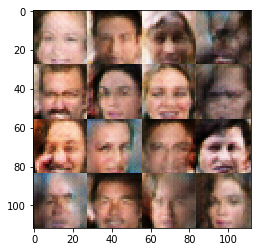

Epoch 1/1... Avg. Discriminator Loss: 1.1036... Avg. Generator Loss: 0.9742


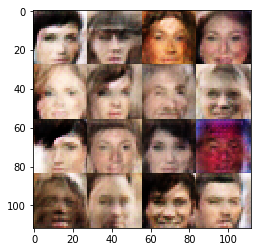

Epoch 1/1... Avg. Discriminator Loss: 1.2576... Avg. Generator Loss: 0.9809


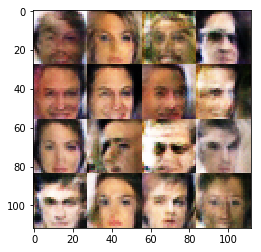

Epoch 1/1... Avg. Discriminator Loss: 1.2164... Avg. Generator Loss: 0.9371


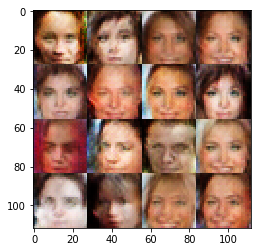

Epoch 1/1... Avg. Discriminator Loss: 1.1710... Avg. Generator Loss: 0.9845


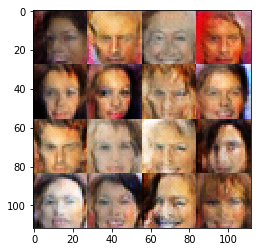

Epoch 1/1... Avg. Discriminator Loss: 1.1582... Avg. Generator Loss: 1.0203


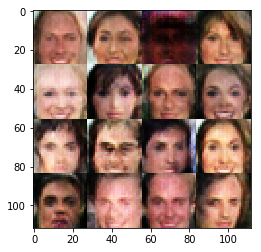

Epoch 1/1... Avg. Discriminator Loss: 1.2086... Avg. Generator Loss: 0.9022


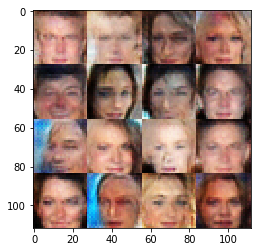

Epoch 1/1... Avg. Discriminator Loss: 1.2516... Avg. Generator Loss: 0.9088


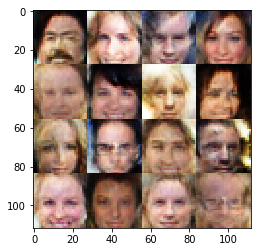

Epoch 1/1... Avg. Discriminator Loss: 1.1884... Avg. Generator Loss: 1.0895


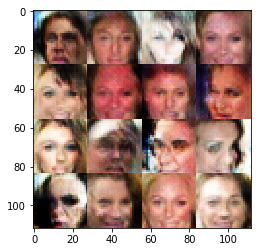

Epoch 1/1... Avg. Discriminator Loss: 1.1981... Avg. Generator Loss: 0.9510


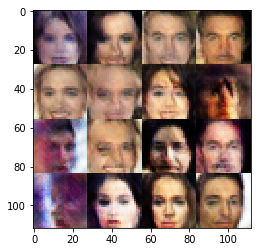

Epoch 1/1... Avg. Discriminator Loss: 1.1544... Avg. Generator Loss: 1.0624


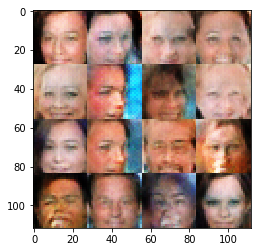

Epoch 1/1... Avg. Discriminator Loss: 1.1698... Avg. Generator Loss: 0.9461


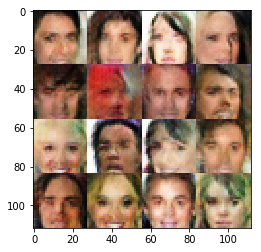

Epoch 1/1... Avg. Discriminator Loss: 1.2775... Avg. Generator Loss: 0.8709


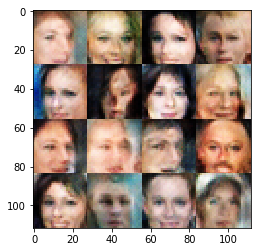

Epoch 1/1... Avg. Discriminator Loss: 1.1840... Avg. Generator Loss: 0.9120


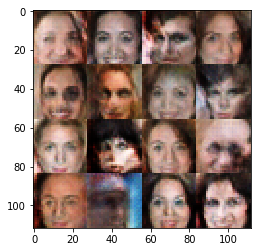

Epoch 1/1... Avg. Discriminator Loss: 1.2164... Avg. Generator Loss: 0.8549


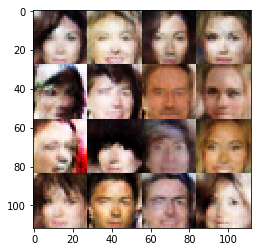

Epoch 1/1... Avg. Discriminator Loss: 1.0193... Avg. Generator Loss: 0.9615


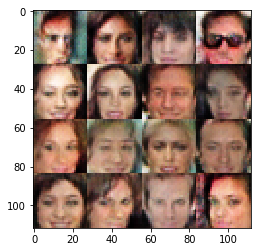

Epoch 1/1... Avg. Discriminator Loss: 1.2112... Avg. Generator Loss: 0.8522


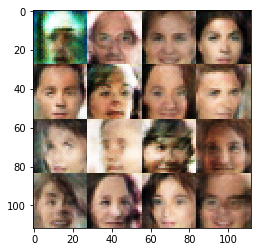

Epoch 1/1... Avg. Discriminator Loss: 1.1327... Avg. Generator Loss: 1.0166


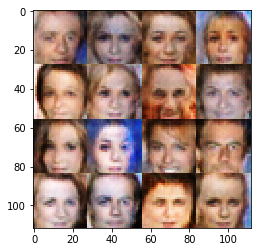

Epoch 1/1... Avg. Discriminator Loss: 1.1957... Avg. Generator Loss: 0.9355


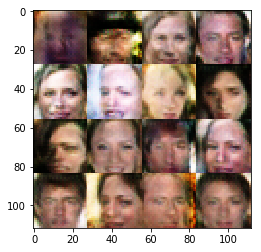

Epoch 1/1... Avg. Discriminator Loss: 1.2938... Avg. Generator Loss: 0.9509


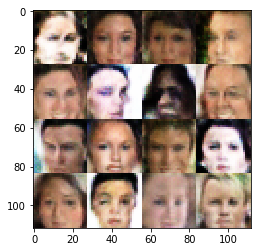

Epoch 1/1... Avg. Discriminator Loss: 1.2117... Avg. Generator Loss: 0.8788


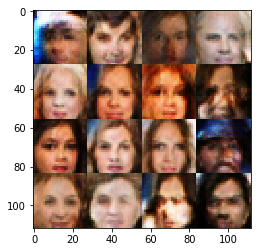

Epoch 1/1... Avg. Discriminator Loss: 1.2844... Avg. Generator Loss: 0.8606


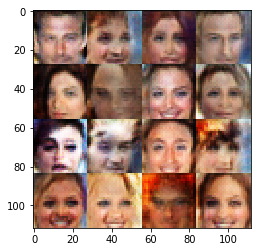

Epoch 1/1... Avg. Discriminator Loss: 1.1416... Avg. Generator Loss: 1.0774


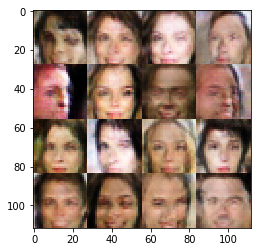

Epoch 1/1... Avg. Discriminator Loss: 1.2258... Avg. Generator Loss: 0.8979


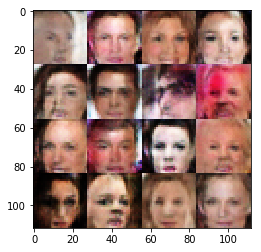

Epoch 1/1... Avg. Discriminator Loss: 1.2331... Avg. Generator Loss: 0.8750


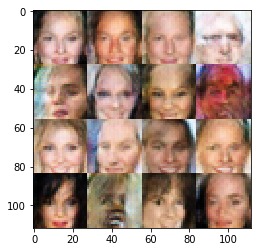

Epoch 1/1... Avg. Discriminator Loss: 1.1797... Avg. Generator Loss: 1.0088


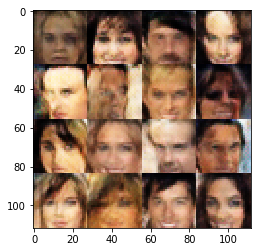

Epoch 1/1... Avg. Discriminator Loss: 1.2155... Avg. Generator Loss: 0.8899


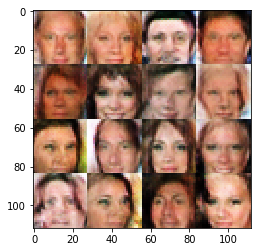

Epoch 1/1... Avg. Discriminator Loss: 1.2877... Avg. Generator Loss: 0.8883


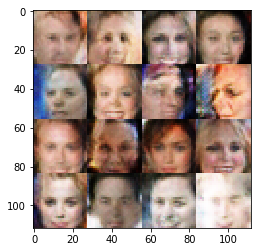

Epoch 1/1... Avg. Discriminator Loss: 1.3097... Avg. Generator Loss: 0.9231


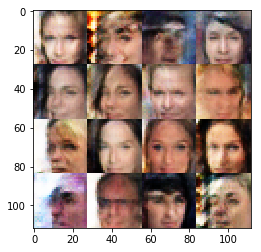

Epoch 1/1... Avg. Discriminator Loss: 1.2257... Avg. Generator Loss: 0.8621


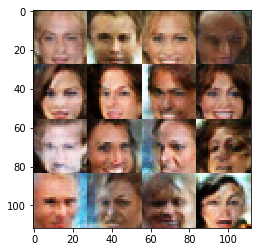

Epoch 1/1... Avg. Discriminator Loss: 1.1749... Avg. Generator Loss: 0.8641


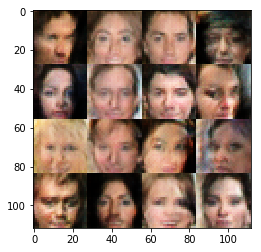

Epoch 1/1... Avg. Discriminator Loss: 1.1655... Avg. Generator Loss: 0.8494


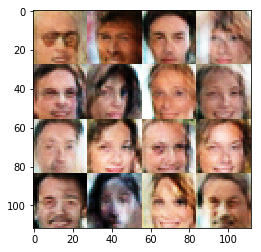

Epoch 1/1... Avg. Discriminator Loss: 1.1949... Avg. Generator Loss: 0.9379


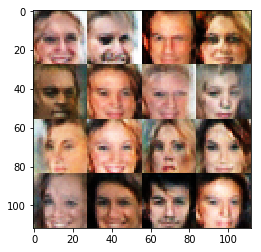

Epoch 1/1... Avg. Discriminator Loss: 1.1683... Avg. Generator Loss: 0.9920


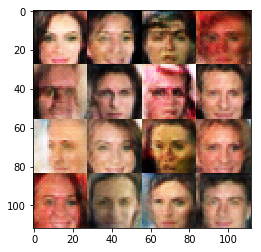

Epoch 1/1... Avg. Discriminator Loss: 1.1897... Avg. Generator Loss: 0.9394


In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.

In [ ]:
print("done")